<h1>EpiScanpy tutorial</h1><br>
In this tutorial we will explore a dataset of <strong>mouse brain</strong>. The data was produced by <strong>10x genomics</strong>. It comprises around <strong>3000 cells</strong>.<br><br><br>
We will follow a typical workflow with steps including:
<ul>
    <li>Creating a count matrix</li>
    <li>Adding metadata</li>
    <li>Quality control</li>
    <li>Create an embedding</li>
    <li>Clustering</li>
    <li>Marker identification</li>
    <li>Visualization</li>
</ul>

bit.ly/3GoWc7a

## Import your packages

In [1]:
# !pip3 install episcanpy leidenalg

In [2]:
import numpy as np
import pandas as pd

import scanpy as sc
import episcanpy as epi
import anndata as ad
import seaborn as sns

import matplotlib.pyplot as plt

import time
import pickle
import os

### Import R related packages

In [3]:
import anndata2ri
import rpy2.rinterface_lib.callbacks as rcb
import rpy2.robjects as ro
import logging

rcb.logger.setLevel(logging.ERROR)
ro.pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

In [4]:
%%R
library(scran)
library(BiocParallel)

### Data

In [5]:
# from google.colab import drive
# drive.mount("/content/drive/", force_remount=True)
# file_path = "/content/drive/My Drive/episcanpy_tutorial/"
file_path = 'data/mouse_brain_5k/'

In [6]:
os.listdir(file_path) # shows all files in file_path

['.ipynb_checkpoints',
 'atac_v1_adult_brain_fresh_5k_fragments.tsv.gz',
 '5k_brain_peaks.narrowPeak',
 'atac_v1_adult_brain_fresh_5k_singlecell.csv',
 '10x-ATAC-Brain5k.h5ad',
 'gencode.vM25.basic.annotation.gtf.gz',
 'description.md']

<br><h3>Setting some initial variables</h3>

In [7]:
name = "5k_brain"

base_dir = "{}".format(file_path)

peak_file = base_dir + "{}_peaks.narrowPeak".format(name)
fragments_file = base_dir + "atac_v1_adult_brain_fresh_5k_fragments.tsv.gz"

gtf_file = base_dir + "gencode.vM25.basic.annotation.gtf.gz"

<br><h3>Load and filter barcode information</h3>

In [8]:
barcode_info = pd.read_csv(base_dir + "atac_v1_adult_brain_fresh_5k_singlecell.csv")
print(barcode_info.is__cell_barcode.value_counts())

0    495824
1      3880
Name: is__cell_barcode, dtype: int64


In [9]:
barcode_info.head()

,barcode,total,duplicate,chimeric,unmapped,lowmapq,mitochondrial,passed_filters,cell_id,is__cell_barcode,TSS_fragments,DNase_sensitive_region_fragments,enhancer_region_fragments,promoter_region_fragments,on_target_fragments,blacklist_region_fragments,peak_region_fragments,peak_region_cutsites
0,NO_BARCODE,4032398,2070733,21036,880066,205322,58820,796421,None,0,0,0,0,0,0,0,0,0
1,AAACGAAAGAAACGCC-1,7,0,0,5,1,0,1,None,0,0,1,1,0,1,0,1,2
2,AAACGAAAGAAAGCAG-1,30,4,0,18,0,0,8,None,0,4,5,3,3,6,0,6,12
3,AAACGAAAGAAAGGGT-1,6,2,0,3,0,0,1,None,0,0,0,0,0,0,0,0,0
4,AAACGAAAGAAATACC-1,22,4,0,3,1,0,14,None,0,7,11,7,6,14,0,11,22


In [10]:
valid_barcodes = barcode_info[barcode_info.is__cell_barcode == 1].barcode.tolist()
valid_barcodes[:5]

['AAACGAAAGTAATCAG-1',
 'AAACGAACACGCTGTG-1',
 'AAACGAATCCTGGGAC-1',
 'AAACGAATCGGGAAAC-1',
 'AAACTCGAGAAAGCAG-1']

<br><h3>Load and add annotation</h3>

In [11]:
anno = ad.read(base_dir + "10x-ATAC-Brain5k.h5ad")
anno

AnnData object with n_obs × n_vars = 2317 × 155093
    obs: 'cell_type', 'domain', 'protocol', 'dataset'
    var: 'feature_types', 'genome', 'chrom', 'chromStart', 'chromEnd', 'n_counts'

In [12]:
anno.obs_names

Index(['AAACGAAAGTAATCAG-1', 'AAACGAACACGCTGTG-1', 'AAACGAATCCTGGGAC-1',
       'AAACTCGAGAAAGCAG-1', 'AAACTCGAGACACTTC-1', 'AAACTCGCAAATTCCG-1',
       'AAACTCGCACATGATC-1', 'AAACTCGGTTAACCAC-1', 'AAACTCGTCCAACGCG-1',
       'AAACTCGTCCATCATT-1',
       ...
       'TTTGGTTGTACCGGCT-1', 'TTTGGTTGTTGAAGCG-1', 'TTTGGTTTCAGATACC-1',
       'TTTGTGTCAGTAGGCA-1', 'TTTGTGTCATAGTCCA-1', 'TTTGTGTGTAACATAG-1',
       'TTTGTGTGTACTTCAG-1', 'TTTGTGTGTCATAAGA-1', 'TTTGTGTTCAGGGTTT-1',
       'TTTGTGTTCTCTGCGT-1'],
      dtype='object', name='cells', length=2317)

In [13]:
anno.obs.cell_type.dtype

CategoricalDtype(categories=['L2/3 IT', 'L4', 'L5 IT', 'L5 PT', 'L6 CT', 'L6 IT', 'NP',
                  'Pvalb', 'Sst', 'Vip'],
, ordered=False)

In [14]:
anno_per_bc = {bc: anno for bc, anno in zip(anno.obs.index, anno.obs.cell_type)}

<br><hr><br><br><h3>Compute the (peak) matrix</h3>

In [15]:
# adata = epi.ct.window_mtx(
#     fragments_file,
#     valid_barcodes,
#     window_size=100000,
#     species="human",
#     fast=True
# )

# adata

In [16]:
# adata = epi.ct.gene_activity_mtx(
#     fragments_file,
#     gtf_file,
#     valid_barcodes,
#     upstream=2000,
#     downstream=0,
#     source="HAVANA",
#     gene_type=["protein_coding"],
#     fast=True
# )

# adata

In [17]:
adata_fragments = epi.ct.peak_mtx(
    fragments_file,
    peak_file, 
    valid_barcodes,
    normalized_peak_size=None,
    fast=False
)

adata_fragments

AnnData object with n_obs × n_vars = 3880 × 189587
    var: 'chr', 'start', 'stop'

In [18]:
adata_fragments.obs["cell_type"] = [anno_per_bc[bc] if bc in anno_per_bc else "No Annotation" for bc in adata_fragments.obs.index.tolist()]
adata_fragments.obs

,cell_type
AAACGAAAGTAATCAG-1,L5 IT
AAACGAACACGCTGTG-1,L2/3 IT
AAACGAATCCTGGGAC-1,L6 IT
AAACGAATCGGGAAAC-1,No Annotation
AAACTCGAGAAAGCAG-1,L2/3 IT
...,...
TTTGTGTGTACTTCAG-1,L4
TTTGTGTGTCATAAGA-1,L2/3 IT
TTTGTGTTCAGGGTTT-1,L6 CT
TTTGTGTTCTCTGCGT-1,L5 IT


<br><hr><br><br><h3>Binarize the matrix and compute QC metrics</h3>

### Poisson assumption

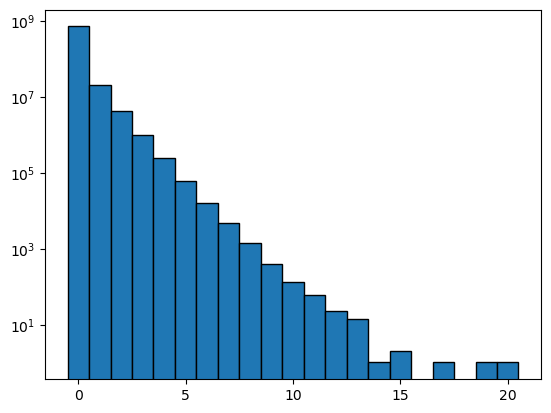

In [19]:
fig = plt.figure()
ax = fig.add_subplot()
data=adata_fragments.X.toarray().flatten()
bins = np.arange(0, data.max() + 1.5) - 0.5
ax.hist(data, log=True, bins=bins, edgecolor='black')
del data

In [20]:
help(np.apply_along_axis)

Help on function apply_along_axis in module numpy:

apply_along_axis(func1d, axis, arr, *args, **kwargs)
    Apply a function to 1-D slices along the given axis.
    
    Execute `func1d(a, *args, **kwargs)` where `func1d` operates on 1-D arrays
    and `a` is a 1-D slice of `arr` along `axis`.
    
    This is equivalent to (but faster than) the following use of `ndindex` and
    `s_`, which sets each of ``ii``, ``jj``, and ``kk`` to a tuple of indices::
    
        Ni, Nk = a.shape[:axis], a.shape[axis+1:]
        for ii in ndindex(Ni):
            for kk in ndindex(Nk):
                f = func1d(arr[ii + s_[:,] + kk])
                Nj = f.shape
                for jj in ndindex(Nj):
                    out[ii + jj + kk] = f[jj]
    
    Equivalently, eliminating the inner loop, this can be expressed as::
    
        Ni, Nk = a.shape[:axis], a.shape[axis+1:]
        for ii in ndindex(Ni):
            for kk in ndindex(Nk):
                out[ii + s_[...,] + kk] = func1d(arr[ii 

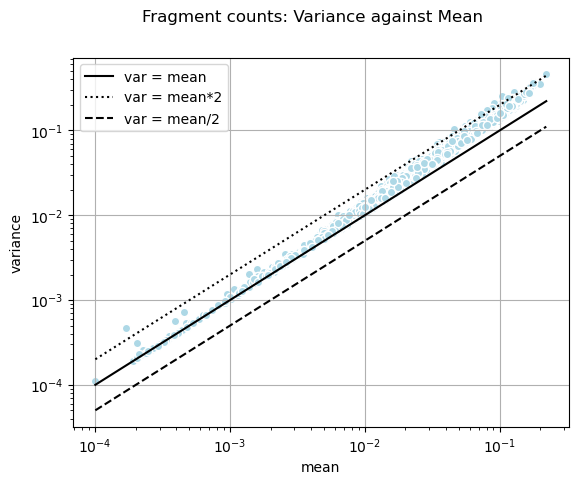

In [21]:
means = np.apply_along_axis(np.mean, 1, adata_fragments.X.toarray())
variances = np.apply_along_axis(np.var, 1, adata_fragments.X.toarray())
x_min = np.min(means)
x_max = np.max(means)
fig = plt.figure()
ax = fig.add_subplot()
ax.grid()
fig.suptitle('Fragment counts: Variance against Mean')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('mean')
ax.set_ylabel('variance')

ax.scatter(means, variances, color='lightblue', edgecolors='white')
ax.plot([x_min,x_max], [x_min,x_max], color='black', label='var = mean')
ax.plot([x_min,x_max], [2*x_min,2*x_max], color='black', linestyle='dotted', label='var = mean*2')
ax.plot([x_min,x_max], [x_min / 2,x_max / 2], color='black', linestyle='dashed', label='var = mean/2')
ax.legend()

In [22]:
adata_fragments

AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type'
    var: 'chr', 'start', 'stop'

In [23]:
print("Max before:\t{}".format(np.max(adata_fragments.X)))
adata_bin = epi.pp.binarize(adata_fragments, copy=True)
print("Max after:\t{}".format(np.max(adata_bin.X)))

Max before:	20.0
Max after:	1.0


In [24]:
adata = adata_bin
adata

AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type'
    var: 'chr', 'start', 'stop'

In [25]:
help(epi.pp.qc_stats)
epi.pp.qc_stats(adata, verbose=True)
adata

Help on function qc_stats in module episcanpy.preprocessing._quality_control:

qc_stats(adata, verbose=True)
    Calculates basic QC metrics like the number of cells in which a feature is present (n_cells), the number of features
    per observation (n_features), and the total number of counts per observation (n_counts). n_counts is only calculated
    if values in the matrix are non-binary.
    
    Args:
        adata: AnnData
        verbose: some feedback
    
    Returns:
        None

added keys n_cells, log_n_cells to .var
added keys n_features, log_n_features to .obs


AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type', 'n_features', 'log_n_features'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells'

The transposase enzyme used in ATAC-Seq is typically able to cut DNA at specific sites, typically at the base of nucleosomes. As a result, fragments that contain a single nucleosome are likely to have a length of around 146 base pairs, which is the approximate length of DNA wrapped around a single nucleosome. Fragments that are longer than this may contain multiple nucleosomes, while fragments that are shorter may not contain any nucleosomes.

In [26]:
help(epi.pp.nucleosome_signal)
epi.pp.nucleosome_signal(adata, fragments_file, n=10000)
adata

Help on function nucleosome_signal in module episcanpy.preprocessing._nucleosome_signal:

nucleosome_signal(adata, fragments, n=10000)
    Calculates the nucleosome signal (mononucleosomal to nucleosome-free ratio).
    
    Args:
        adata: AnnData
        fragments: path to fragments file
        n: number of cell-associated fragments to consider per barcode in AnnData
    
    Returns:
        None



AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells'
    uns: 'fragment_lengths'

In [27]:
help(epi.pp.tss_enrichment)
epi.pp.tss_enrichment(adata, gtf=gtf_file, fragments=fragments_file, n=5000, score="avg_score_of_center_region", distance_to_tss=1000, bp_per_flank=100)
adata

Help on function tss_enrichment in module episcanpy.preprocessing._tss_enrichment:

tss_enrichment(adata, fragments, gtf, n=5000, score='avg_score_of_center_region', distance_to_tss=1000, bp_per_flank=100, comment='#')
    Computes the TSS profile for every observation.
    
    Args:
        adata: AnnData
        fragments: path to fragments file
        gtf: path to GTF file
        n: number of TSS to use for calculation
        score: value that is used as TSS enrichment score for individual observations
        distance_to_tss: distance to TSS
        bp_per_flank: number of base pair per flank to use for normalization
        comment: character that marks comments
    
    Returns:
        None



AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal', 'tss_enrichment_score'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells'
    uns: 'fragment_lengths', 'tss_enrichment'

In [28]:
# The lazy_qc function runs qc_stats, nucleosome_signal, and tss_enrichment with default parameters.

# epi.pp.lazy_qc(adata, fragments=fragments_file, gtf=gtf_file)

In [29]:
adata

AnnData object with n_obs × n_vars = 3880 × 189587
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal', 'tss_enrichment_score'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells'
    uns: 'fragment_lengths', 'tss_enrichment'

<br><hr><br><br><h3>QC visualization + determine filtering thresholds</h3>

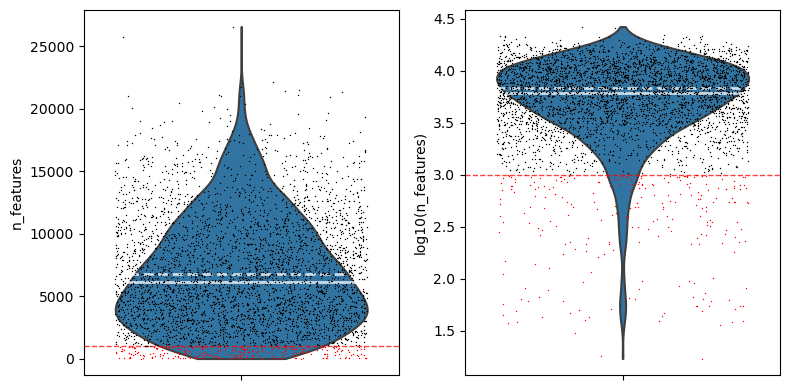

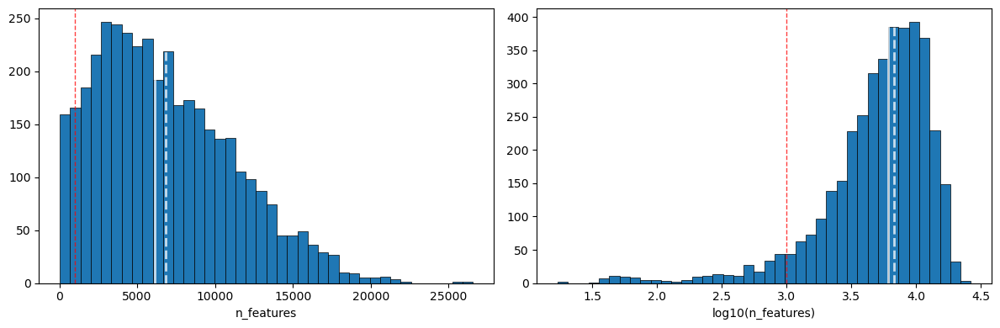

Max:	26571
Median:	6124.5
Mean:	6804.136340206185
Min:	17


In [30]:
min_features = 1000
max_features = None

epi.pl.violin(adata, "n_features", min_threshold=min_features, max_threshold=max_features, show_log=True, show_mean=True, show_median=True, print_statistics=False, save=None)
epi.pl.histogram(adata, "n_features", bins=40, min_threshold=min_features, max_threshold=max_features, show_log=True, show_mean=True, show_median=True, print_statistics=True, save=None)

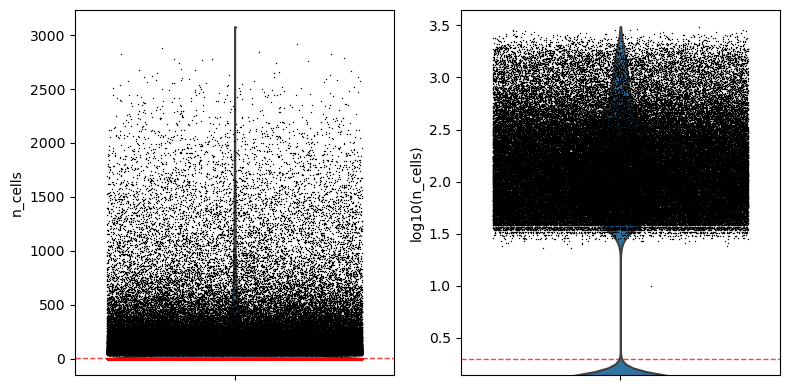

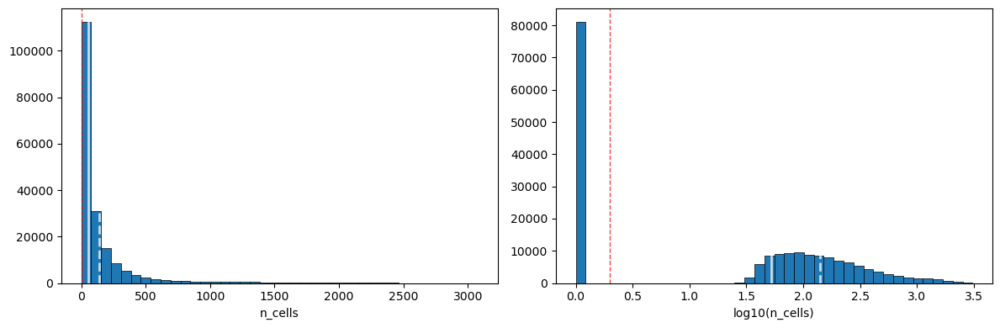

Max:	3079
Median:	52.0
Mean:	139.25031252142816
Min:	0


In [31]:
min_cells = 2
max_cells = None

epi.pl.violin(adata, "n_cells", min_threshold=min_cells, max_threshold=max_cells, show_log=True, show_mean=True, show_median=True, print_statistics=False, save=None)
epi.pl.histogram(adata, "n_cells", bins=40, min_threshold=min_cells, max_threshold=max_cells, show_log=True, show_mean=True, show_median=True, print_statistics=True, save=None)

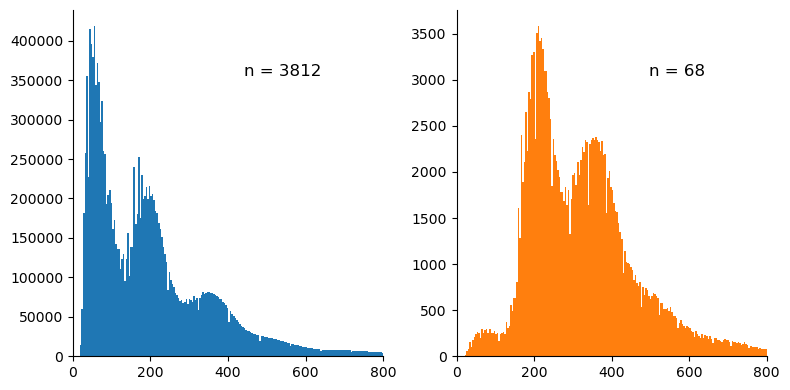

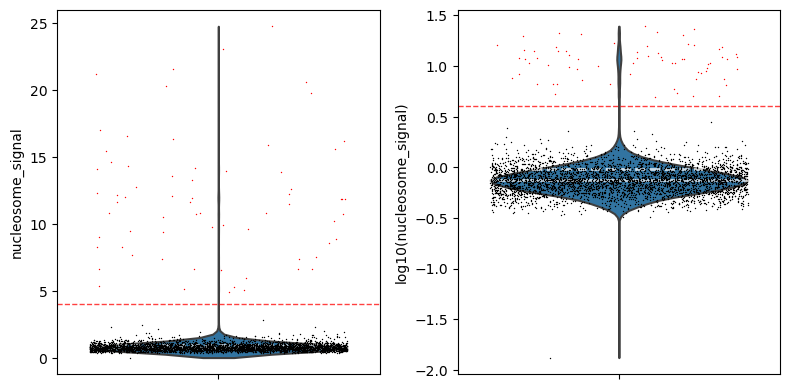

Max:	24.763636363636362
Median:	0.7455087446527191
Mean:	0.9676022149952296
Min:	0.013245033112582781


In [32]:
max_nucleosome_signal = 4

epi.pl.fragment_length(adata, n=5000, threshold=max_nucleosome_signal, show_n=True)
epi.pl.violin(adata, "nucleosome_signal", max_threshold=max_nucleosome_signal, show_log=True, show_mean=True, show_median=True, print_statistics=True, save=None)

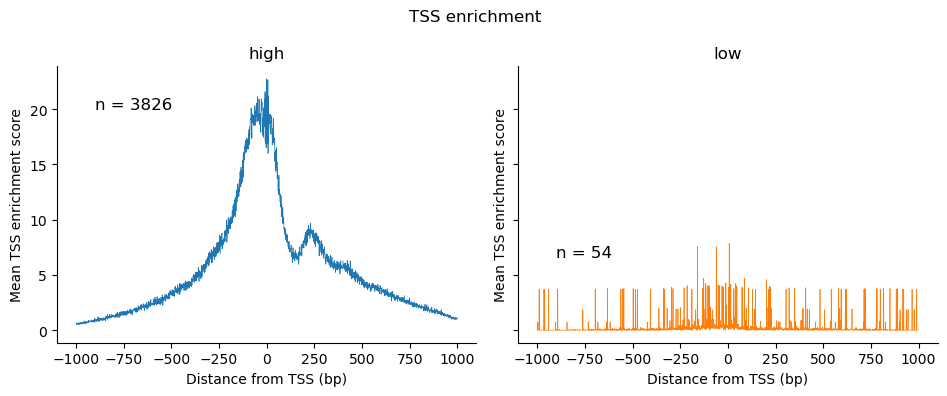

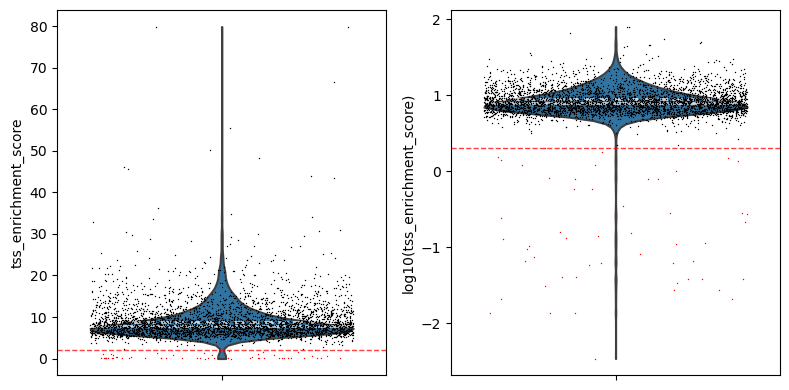

Max:	79.92007992007991
Median:	7.797021572531776
Mean:	8.879653820375259
Min:	0.0


In [33]:
min_tss_enrichment = 2

adata.obs["tss"] = ["high" if val > min_tss_enrichment else "low" for val in adata.obs.tss_enrichment_score]

epi.pl.tss_enrichment(adata, group_by="tss", show_n=True)
epi.pl.violin(adata, "tss_enrichment_score", min_threshold=min_tss_enrichment, show_log=True, show_mean=True, show_median=True, print_statistics=True, save=None)

<br><hr><br><br><h3>Set, check, and apply filters</h3>

In [34]:
epi.pp.set_filter(adata, "n_features", min_threshold=min_features, max_threshold=max_features)
epi.pp.set_filter(adata, "nucleosome_signal", max_threshold=max_nucleosome_signal)
epi.pp.set_filter(adata, "tss_enrichment_score", min_threshold=min_tss_enrichment)

epi.pp.set_filter(adata, "n_cells", min_threshold=min_cells)

3633 of 3880 observations remain (-247)
3812 of 3880 observations remain (-68)
3826 of 3880 observations remain (-54)
108390 of 189587 features remain (-81197)


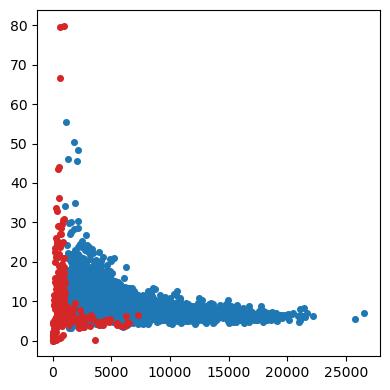

In [35]:
epi.pl.show_filters(adata, x="n_features", y="tss_enrichment_score", save=None)

In [36]:
adata = epi.pp.apply_filters(adata, verbose=True)

3577 of 3880 observations remain (-303)
108390 of 189587 features remain (-81197)


<br><hr><br><br><h3>Select highly variable features</h3>

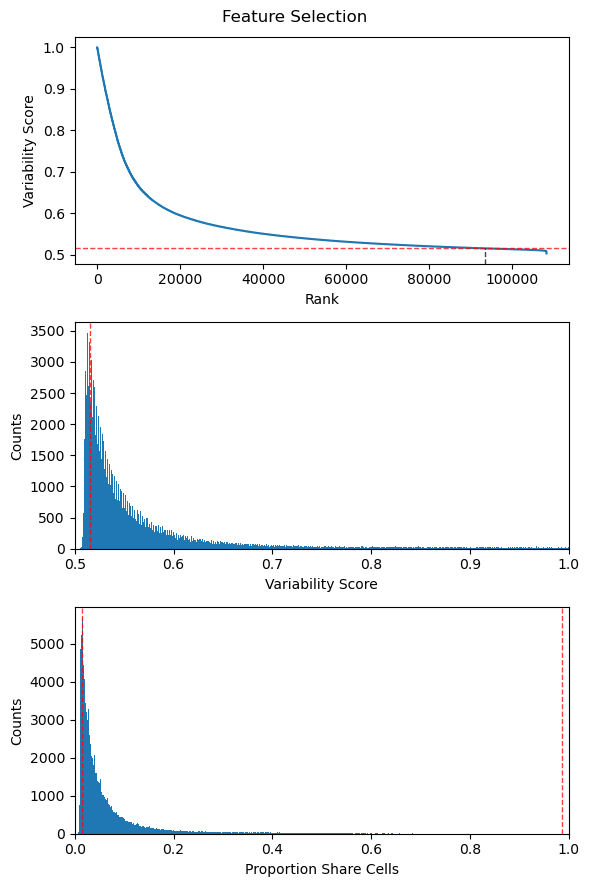

In [37]:
epi.pp.highly_variable(adata, min_score=0.515, n_features=None)

In [38]:
adata = epi.pp.select_highly_variable(adata, verbose=True)

93556 of 108390 features remain (-14834)


In [39]:
adata

AnnData object with n_obs × n_vars = 3577 × 93556
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal', 'tss_enrichment_score', 'tss', 'passes_filter'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells', 'passes_filter', 'prop_shared_cells', 'variability_score', 'highly_variable'
    uns: 'fragment_lengths', 'tss_enrichment'

<br><hr><br><br><h3>Normalization and log-transformation</h3>

In [40]:
epi.pp.normalize_total(adata)
adata

AnnData object with n_obs × n_vars = 3577 × 93556
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal', 'tss_enrichment_score', 'tss', 'passes_filter'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells', 'passes_filter', 'prop_shared_cells', 'variability_score', 'highly_variable'
    uns: 'fragment_lengths', 'tss_enrichment'

In [41]:
epi.pp.log1p(adata)
adata

AnnData object with n_obs × n_vars = 3577 × 93556
    obs: 'cell_type', 'n_features', 'log_n_features', 'nucleosome_signal', 'tss_enrichment_score', 'tss', 'passes_filter'
    var: 'chr', 'start', 'stop', 'n_cells', 'log_n_cells', 'passes_filter', 'prop_shared_cells', 'variability_score', 'highly_variable'
    uns: 'fragment_lengths', 'tss_enrichment', 'log1p'

<br><hr><br><br><h3>Principal component analysis, neighborhood graph, UMAP, and visualization</h3>

In [46]:
help(epi.pp.find_elbow)

Help on function find_elbow in module episcanpy.preprocessing._kneedle:

find_elbow(adata, use_log=False, show_anno=False, figsize=None, save=None)
    Uses the kneedle algorithm to identify the elbow point (maximum curviture) of the scree plot. Can be used to
    determine the number of components to use after PCA.
    
    Args:
        adata: AnnData object
        use_log: whether to identify the elbow point on the log-transformed data
        show_anno: some additional annotation
        figsize: size of the figure
        save: if True or str, save the figure. str represents entire path. filetype is inferred.
    
    Returns:
        int (elbow point)



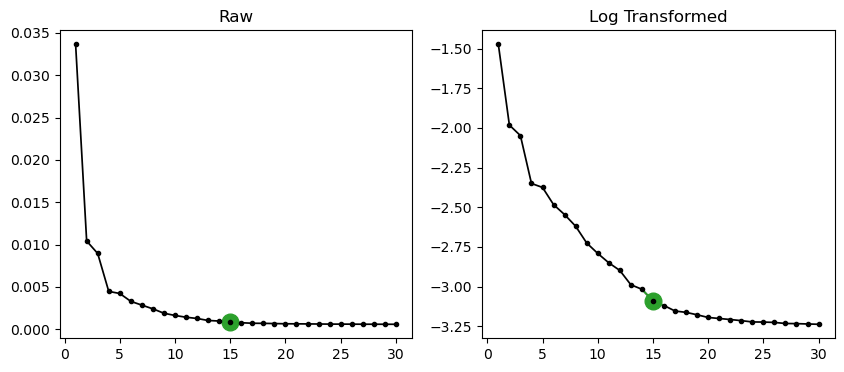

In [45]:
epi.pp.pca(adata, n_comps=30)
n_comps = epi.pp.find_elbow(adata, use_log=True, show_anno=False)

In [47]:
epi.pp.neighbors(adata, n_pcs=n_comps, method="umap")

In [48]:
epi.tl.umap(adata)

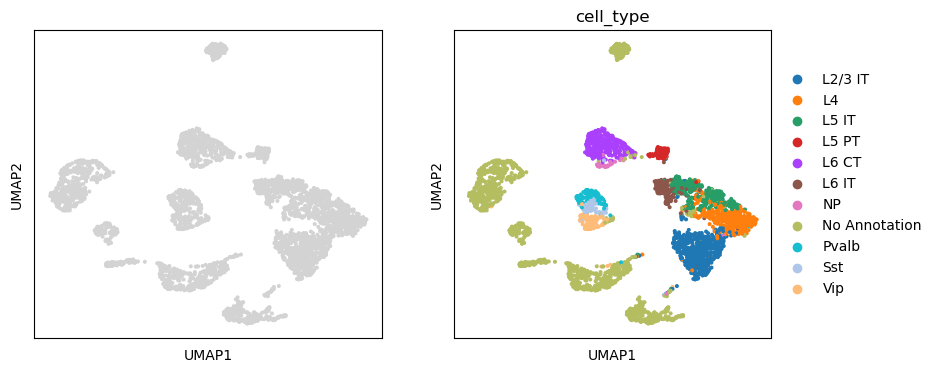

In [49]:
plt.rcParams["figure.figsize"]= (4, 4)
epi.pl.umap(adata, color=[None, "cell_type"])

<br>Let's try again with a higher number of components

In [66]:
epi.pp.neighbors(adata, n_pcs=22, method="umap")

In [67]:
epi.tl.umap(adata)

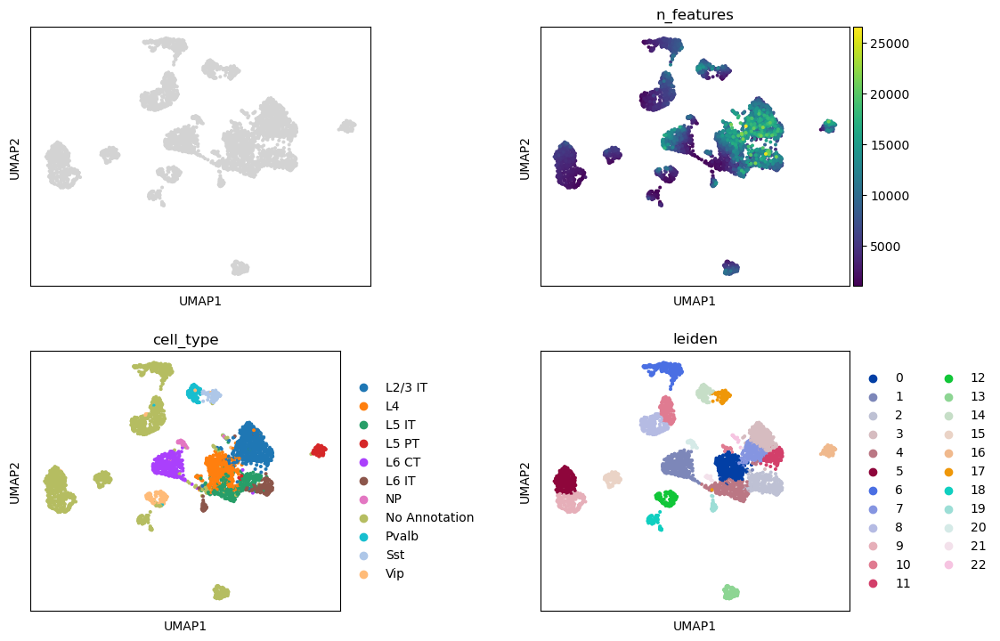

In [68]:
epi.tl.leiden(adata, resolution=1.2)
epi.pl.umap(adata, color=[None, "n_features", "cell_type", "leiden"], ncols=2, wspace=0.5)

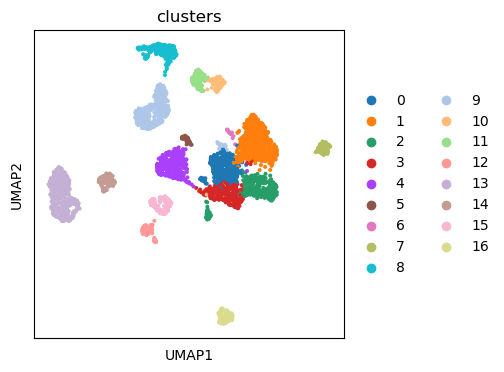

In [69]:
new_clusters = [[0, 21], [7, 11, 3], [2, 19], [4], [1], [20], [22], [16], [6], [8, 10], [17], [14], [18], [5, 9], [15], [12], [13]]
new_clusters = {str(old): str(new) for new, olds in enumerate(new_clusters) for old in olds}

adata.obs["clusters"] = [new_clusters[old_cluster] for old_cluster in adata.obs.leiden]
epi.pl.umap(adata, color=["clusters"])

<br><hr><br><br><h3>Marker identification</h3>

In [50]:
help(epi.tl.rank_features)

Help on function rank_features in module episcanpy.tools._features_selection:

rank_features(adata, groupby, omic=None, use_raw=True, groups='all', reference='rest', n_features=100, rankby_abs=False, key_added='rank_features_groups', copy=False, method='', corr_method='benjamini-hochberg', **kwds)
    It is a wrap-up function of scanpy sc.tl.rank_genes_groups function. For more information see
    Scanpy documentations.
    
    Here, we optimised the default features for the different kind of omics epiScanpy is analysing.
    Parameters for rankby_abs, method and corr_method are fixed byt the omic (if not specified otherwise)
    
    In case you want to change all the settings, it is advise to directly use the Scanpy function
    or to specify the omic parameter as False.
    
    If the omic of the input AnnData object is not specified (or incorrect), you can add it in omic
    (either 'RNA', 'ATAC' or 'methylation'). If the omic of the current matrix is not known by
    epiScanpy b

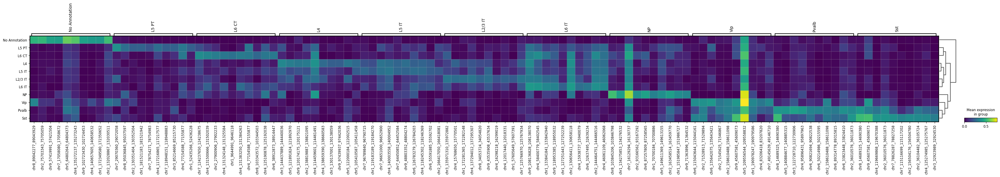

In [70]:
epi.tl.rank_features(adata, groupby="cell_type", use_raw=False, omic="ATAC")
epi.pl.rank_feat_groups_matrixplot(adata)

In [71]:
groups = [group for group in adata.obs.cell_type.cat.categories]

new_markers = {group: adata.uns["rank_features_groups"]["names"][group].tolist()[:8] for group in groups}

L2/3 IT


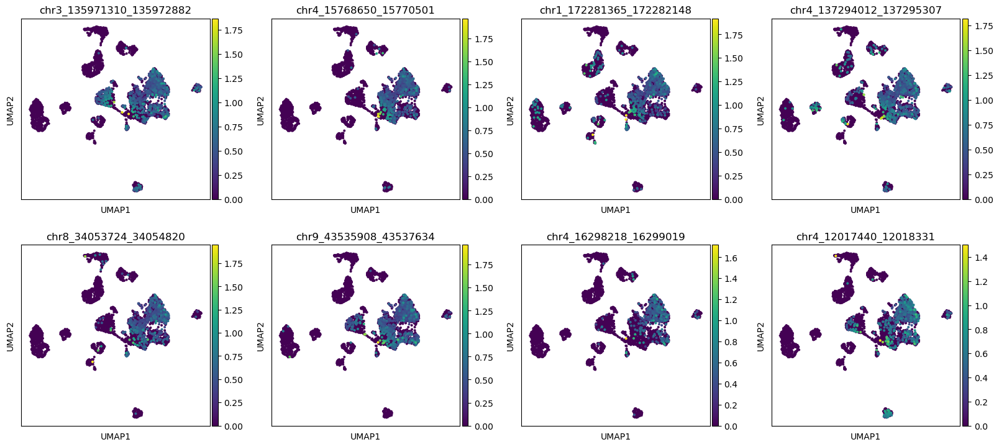

L4


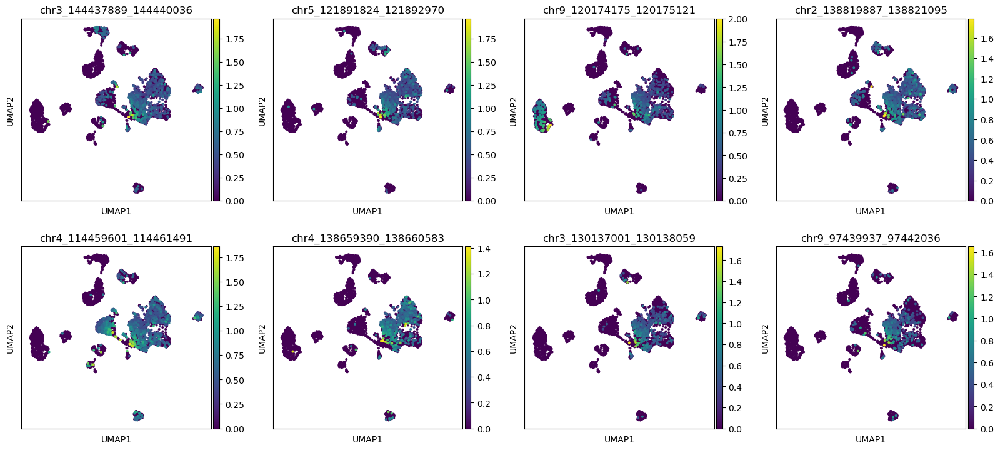

L5 IT


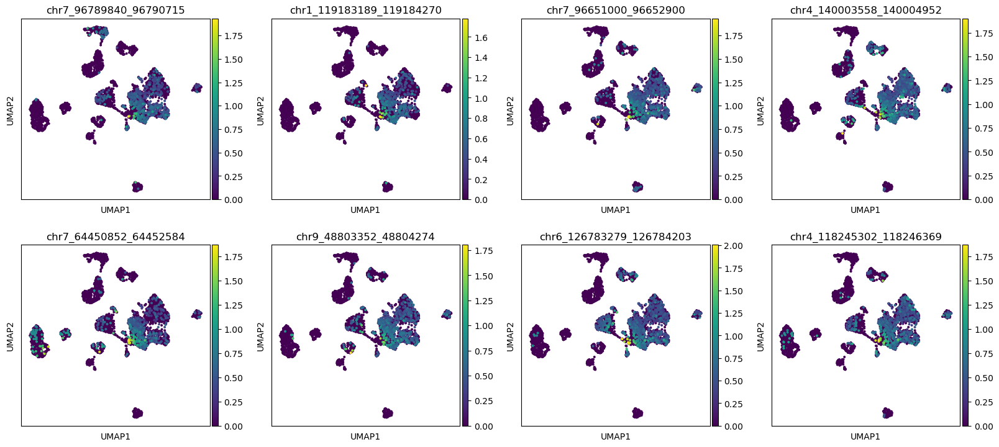

L5 PT


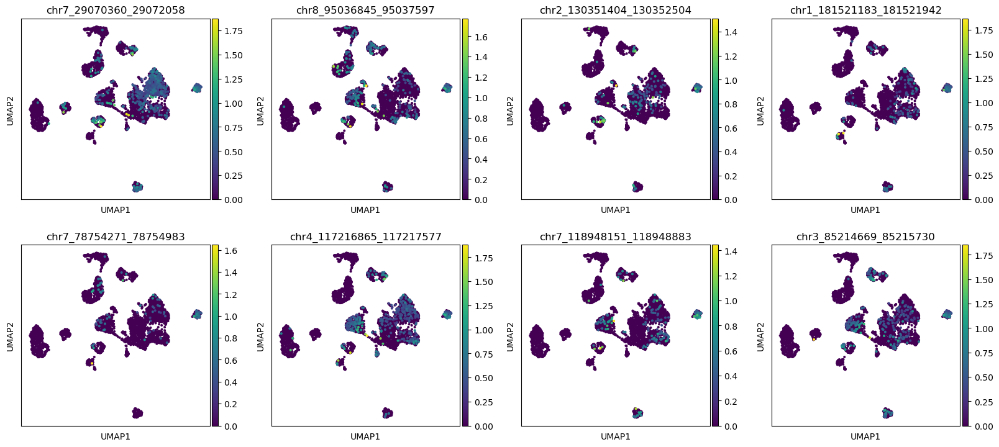

L6 CT


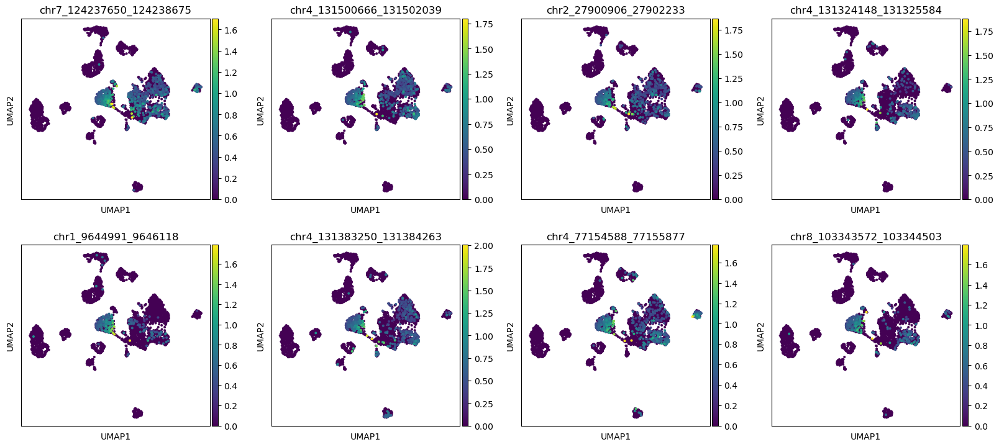

L6 IT


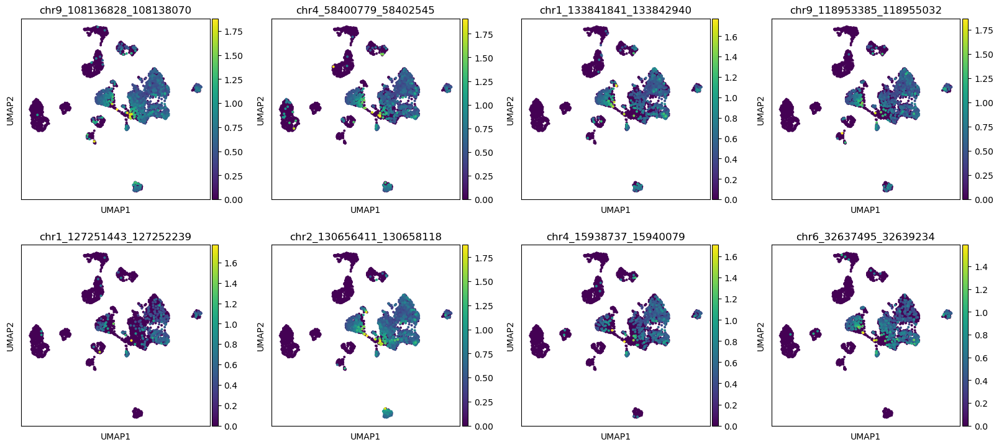

NP


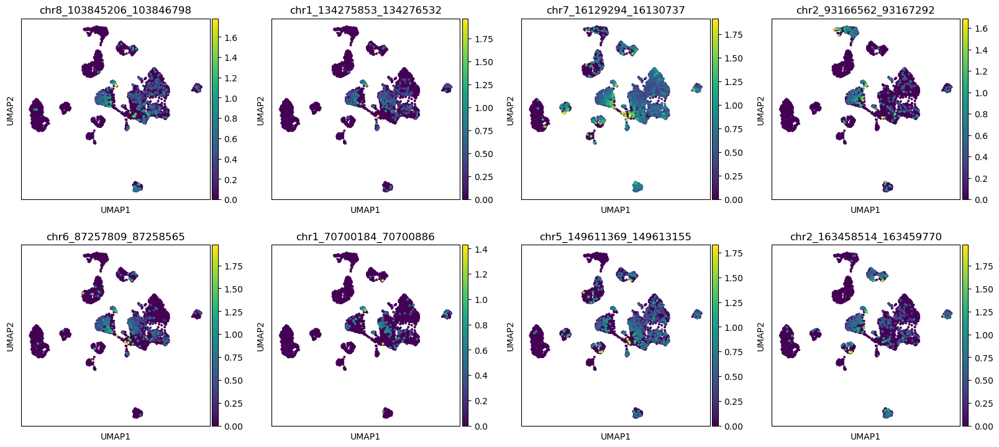

No Annotation


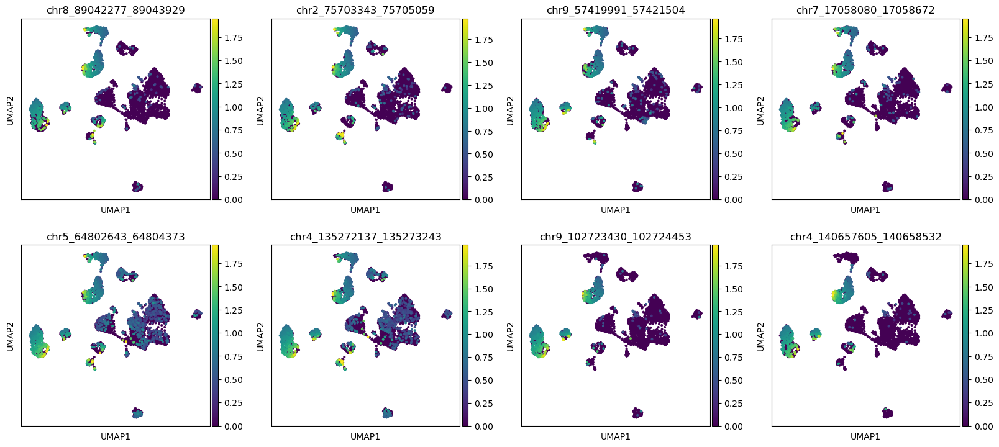

Pvalb


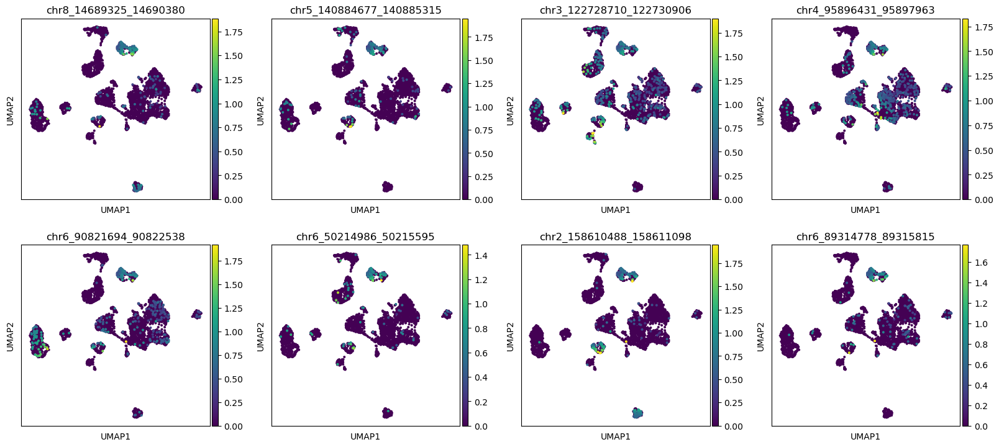

Sst


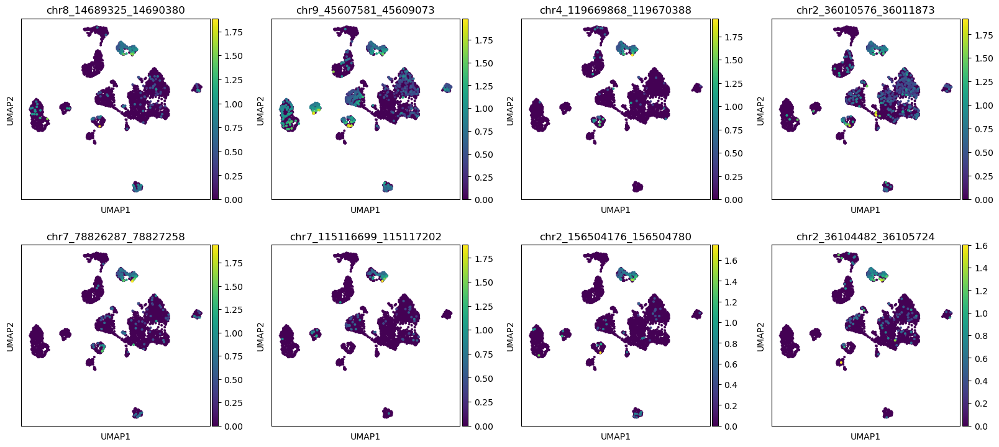

Vip


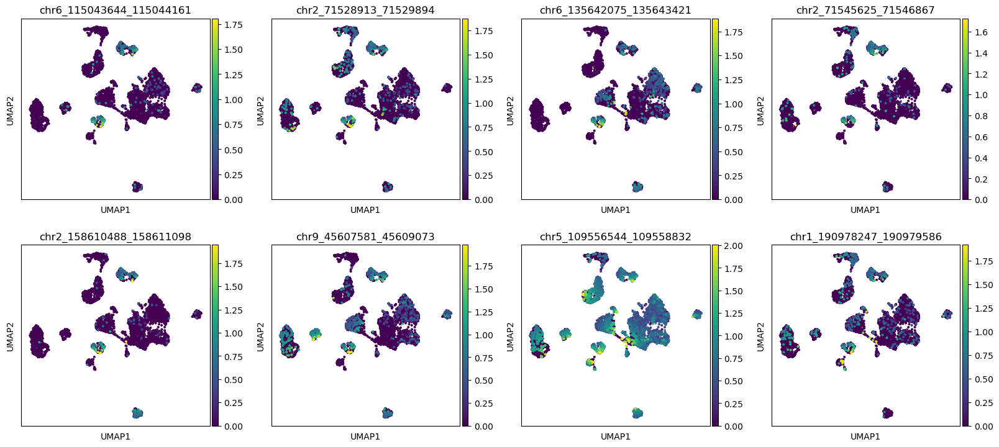

In [72]:
for cell_type, markers in new_markers.items():
    print(cell_type)
    epi.pl.umap(adata, color=markers)

<br><hr><br><br><h3>Compute the gene activity matrix</h3>

In [73]:
gene_activity = epi.ct.gene_activity_mtx(
    fragments_file,
    gtf_file,
    valid_barcodes,
    upstream=2000,
    downstream=0,
    source="HAVANA",
    gene_type=["protein_coding"],
    fast=False
)

gene_activity

AnnData object with n_obs × n_vars = 3880 × 21673
    var: 'gene_name', 'gene_id', 'gene_type', 'chr', 'start', 'stop', 'strand', 'source'

In [74]:
gene_activity = gene_activity[adata.obs.index.tolist()].copy()

In [75]:
gene_activity.obs["cell_type"] = adata.obs.cell_type
gene_activity.obs["clusters"] = adata.obs.clusters

In [76]:
gene_activity.var.index = gene_activity.var.gene_name
gene_activity.var_names_make_unique()

<br><hr><br><br><h3>Normalization and log-transformation</h3>

In [77]:
epi.pp.normalize_total(gene_activity)
gene_activity.layers["normalized"] = gene_activity.X.copy()
epi.pp.log1p(gene_activity)

<br><hr><br><br><h3>Select highly variable features</h3>

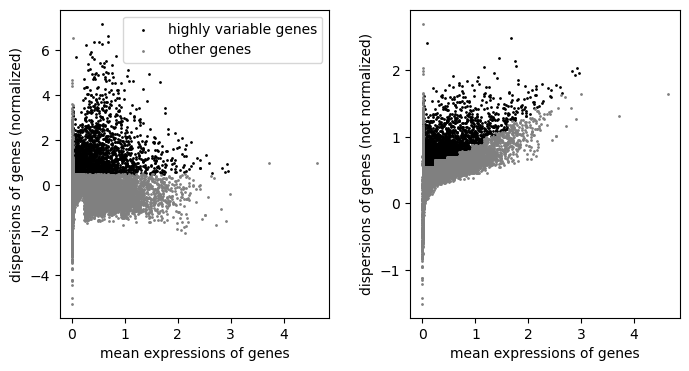

In [78]:
sc.pp.highly_variable_genes(gene_activity)
sc.pl.highly_variable_genes(gene_activity)

<br><hr><br><br><h3>Principal component analysis, neighborhood graph, UMAP, and visualization</h3>

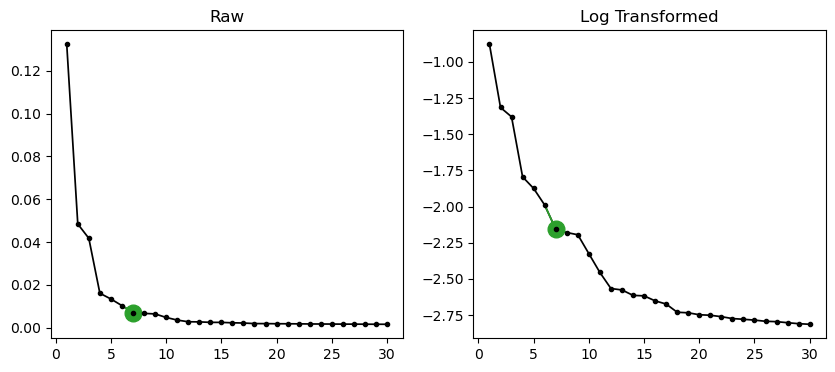

In [79]:
epi.pp.pca(gene_activity, n_comps=30, use_highly_variable=True)
n_comps = epi.pp.find_elbow(gene_activity, use_log=True)

In [80]:
epi.pp.neighbors(gene_activity, n_neighbors=15, n_pcs=n_comps, method="umap")
epi.tl.umap(gene_activity)

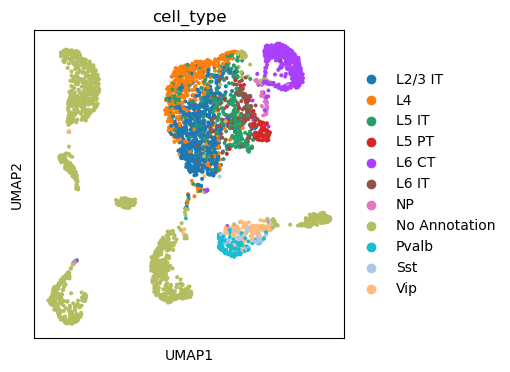

In [81]:
plt.rcParams["figure.figsize"]= (4, 4)
epi.pl.umap(gene_activity, color=["cell_type"])

<br><hr><br><br><h3>Transfer peak embedding to gene activity AnnData object</h3>

In [82]:
gene_activity.obsm["X_umap"] = adata.obsm["X_umap"]

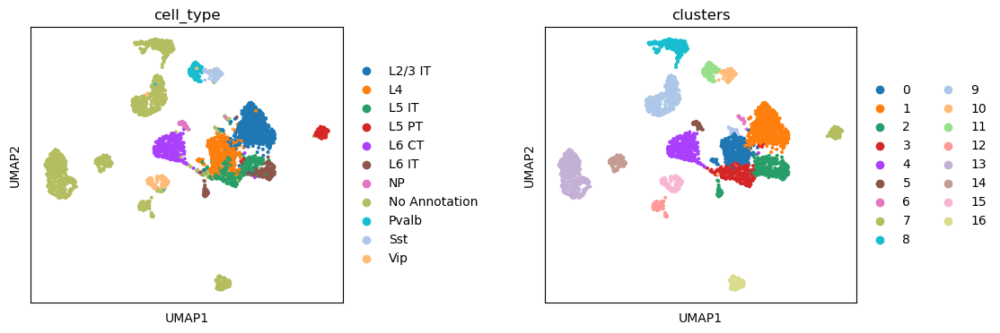

In [83]:
epi.pl.umap(gene_activity, color=["cell_type", "clusters"], wspace=0.5)

<br><hr><br><br><h3>Markers</h3>

Neuron


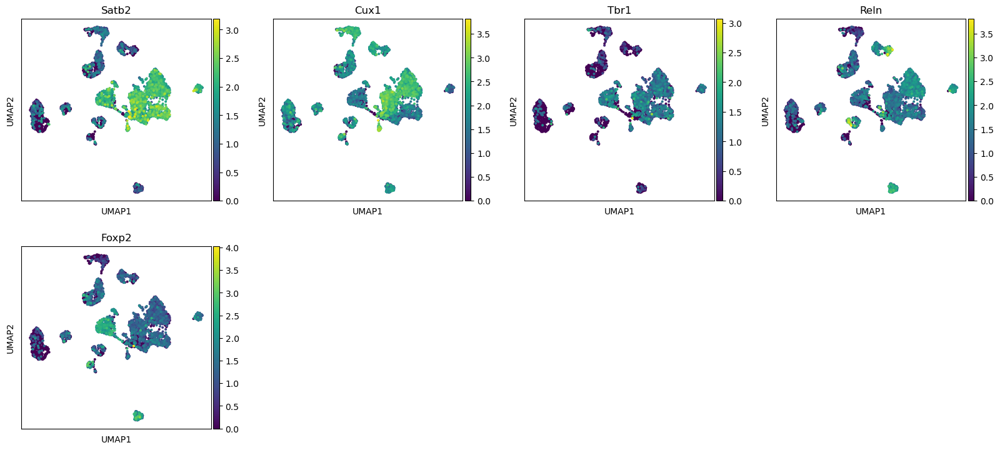

Immature


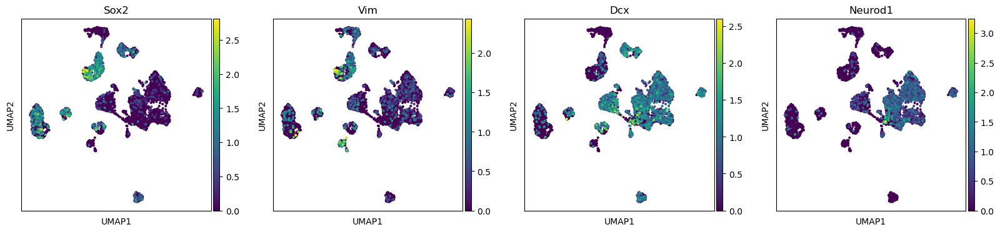

Microglia


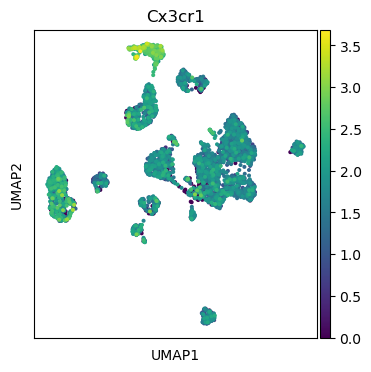

Mature Oligo


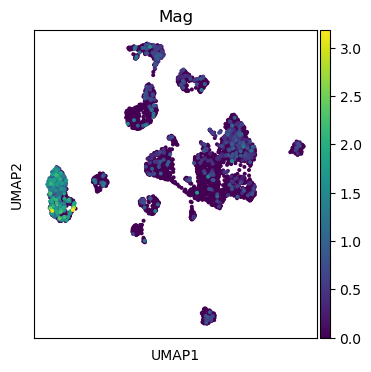

Pro-myelinating oligo


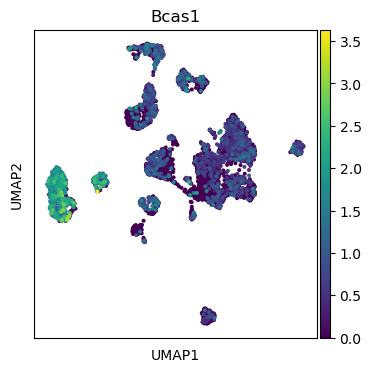

OPCs


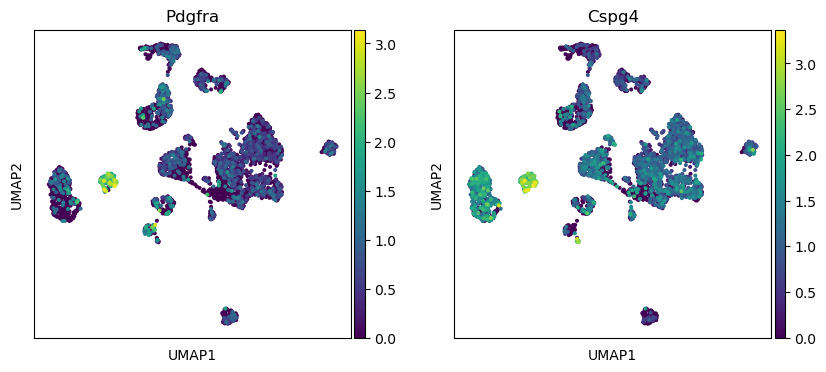

Astrocytes


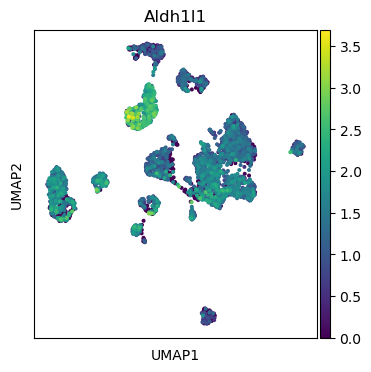

Endo


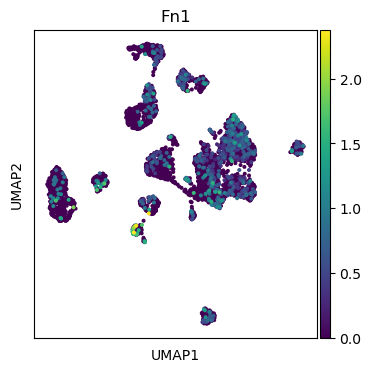

In [84]:
marker_genes_dict = {
    'Neuron':  ['Rbfox3', 'Satb2', 'Cux1','Tbr1',"Reln","Fezf2","Foxp2", 'Pvalb','Sst'],
    'Immature': ["Sox2", "Vim","Dcx","Tubb3","Neurod1", "Ascl1"],
    'Microglia': ['P2ry12','Cx3cr1'],
    'Mature Oligo': ['Olig1','Olig2', 'Mbp', 'Mog','Mag','Cnp','Sox10'],
    'Pro-myelinating oligo': ['Bcas1'],
    'OPCs': ['Pdgfra', 'Cspg4'],
    'Astrocytes': ['Gfap', 'Aldh1l1','S100b','Sox9','Aqp4'],
    'Endo': ['Fn1', 'Cldn5'],
}

for cell_type, markers in marker_genes_dict.items():
    print(cell_type)
    markers = [marker for marker in markers if gene_activity[:, marker].X.sum() > 0]
    epi.pl.umap(gene_activity, color=markers)

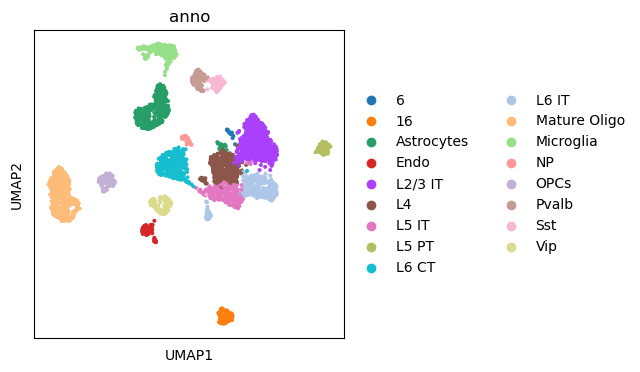

In [85]:
anno_per_cluster = {"0": "L4", 
 "1": "L2/3 IT",
 "2": "L6 IT",
 "3": "L5 IT",
 "4": "L6 CT",
 "5": "NP",
 "6": "6",
 "7": "L5 PT",
 "8": "Microglia",
 "9": "Astrocytes",
 "10": "Sst",
 "11": "Pvalb",
 "12": "Endo",
 "13": "Mature Oligo",
 "14": "OPCs",
 "15": "Vip",
 "16": "16"}

gene_activity.obs["anno"] = [anno_per_cluster[cluster] for cluster in gene_activity.obs.clusters]
epi.pl.umap(gene_activity, color=["anno"])

<br><hr><br><br><h3>Marker identification</h3>

In [86]:
sc.tl.rank_genes_groups(gene_activity, "anno")

In [87]:
groups = [group for group in gene_activity.obs.anno.cat.categories]
new_markers = {group: gene_activity.uns["rank_genes_groups"]["names"][group].tolist()[:8] for group in groups}

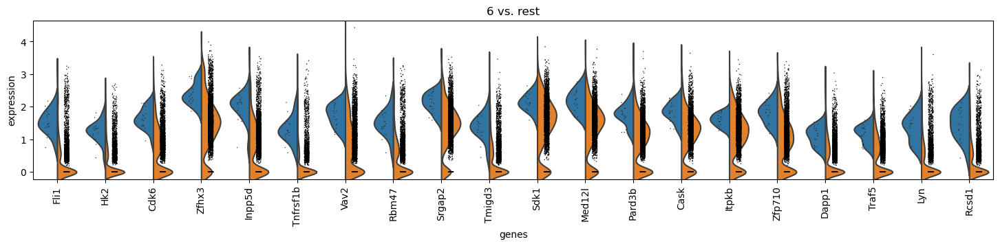

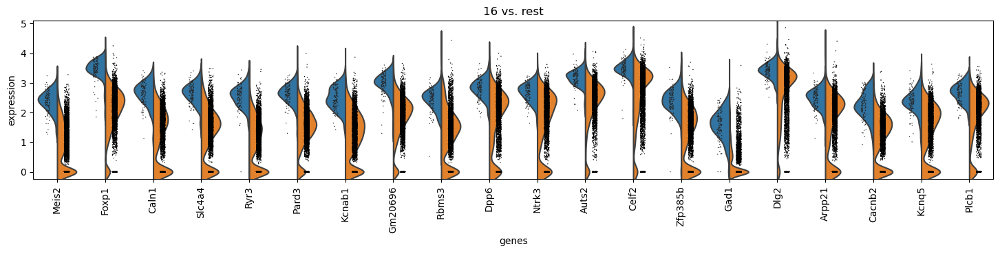

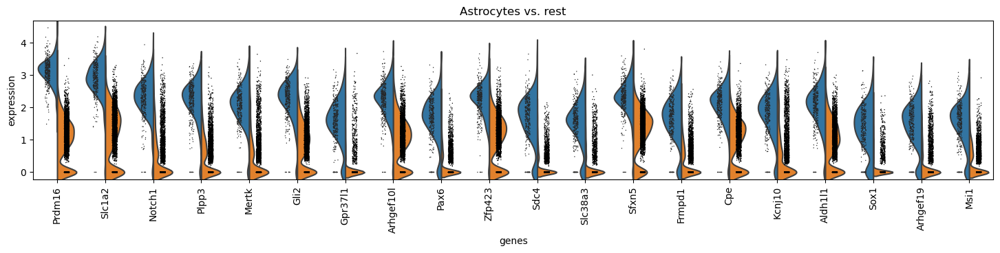

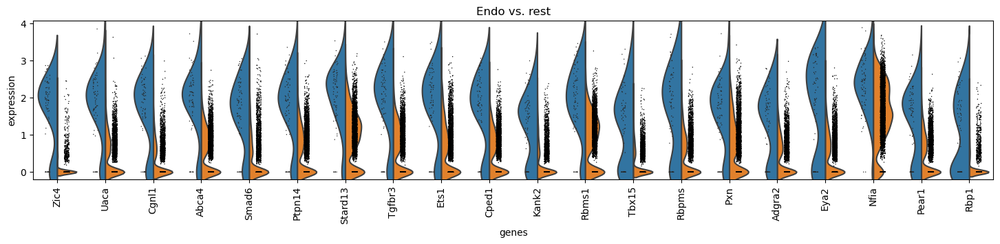

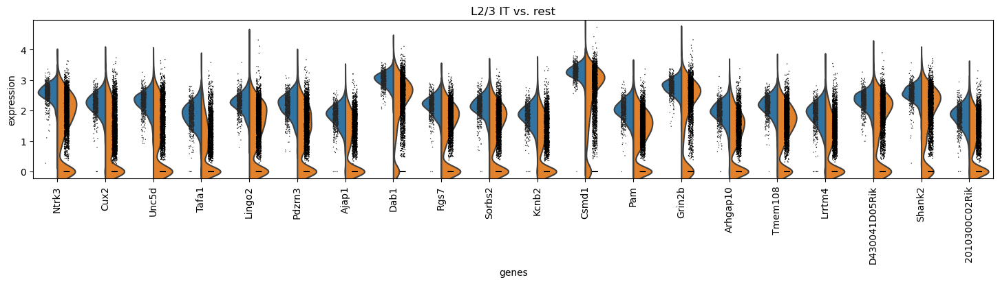

...

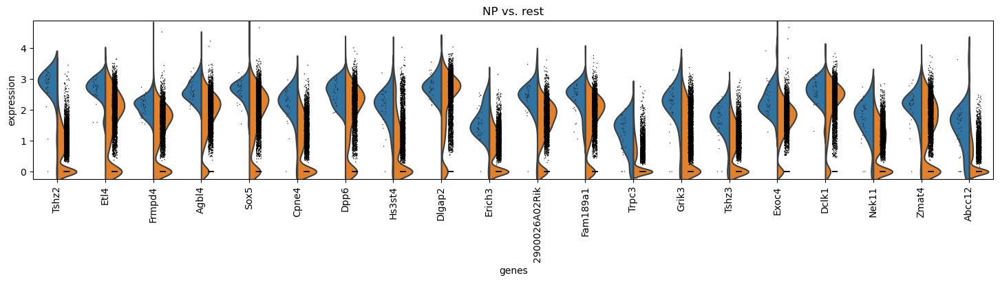

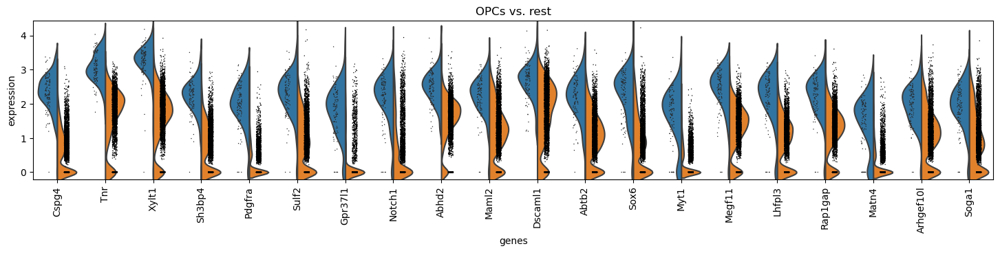

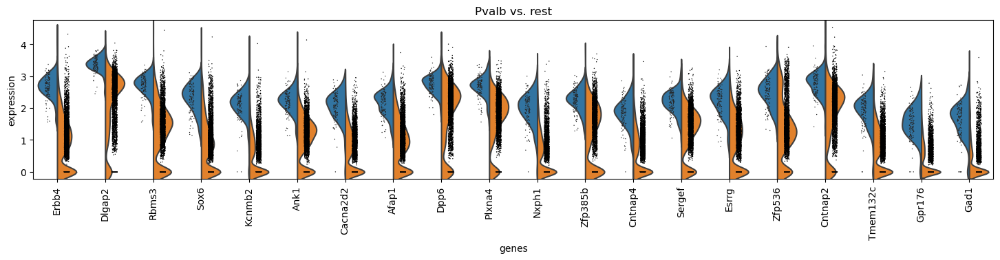

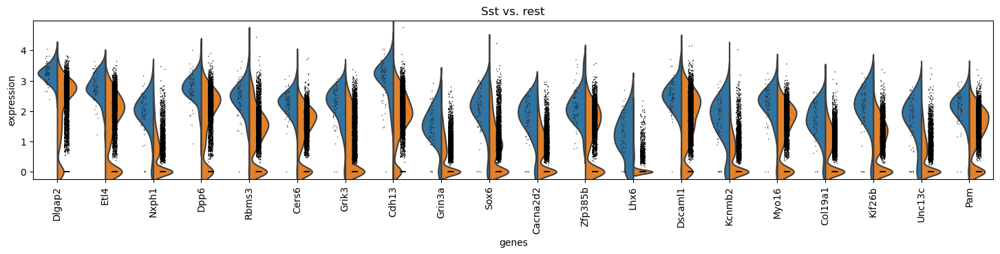

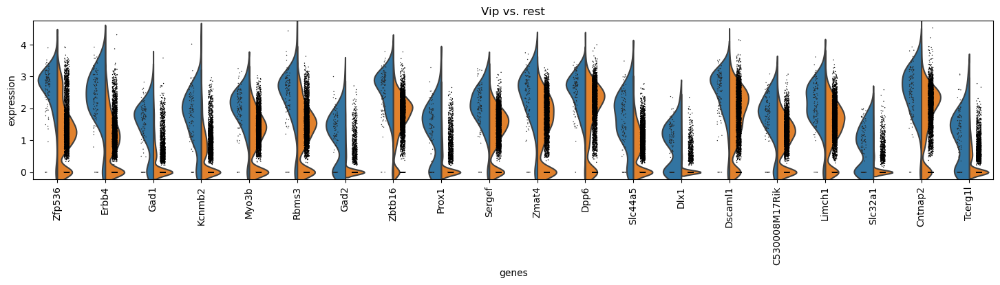

In [88]:
plt.rcParams["figure.figsize"]= (18, 3)
epi.pl.rank_feat_groups_violin(gene_activity, key="rank_genes_groups")

6


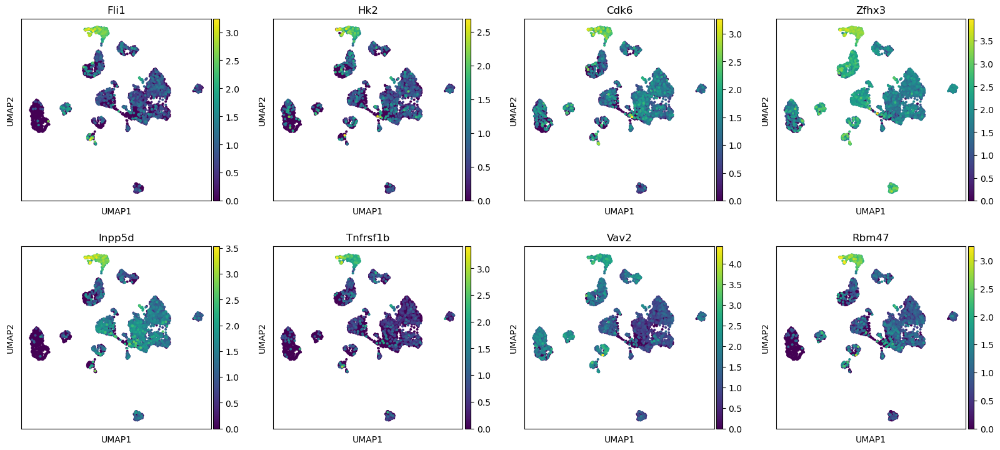

16


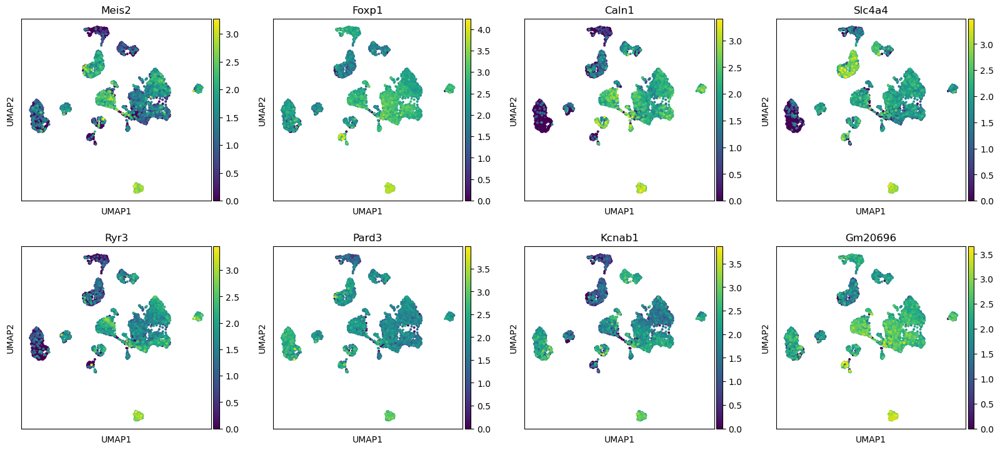

Astrocytes


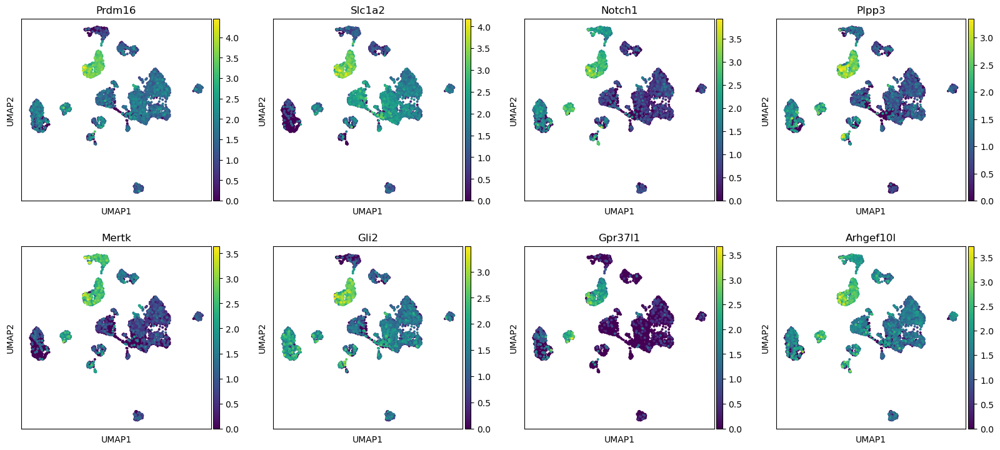

Endo


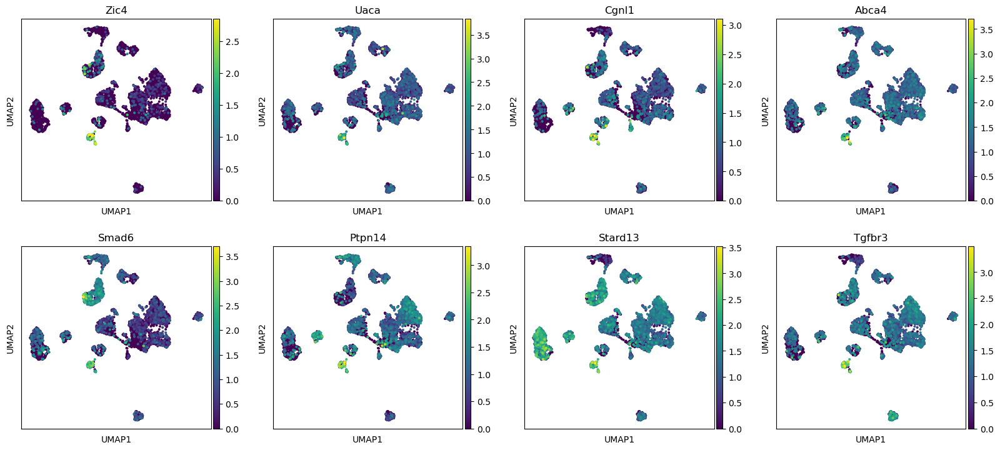

L2/3 IT


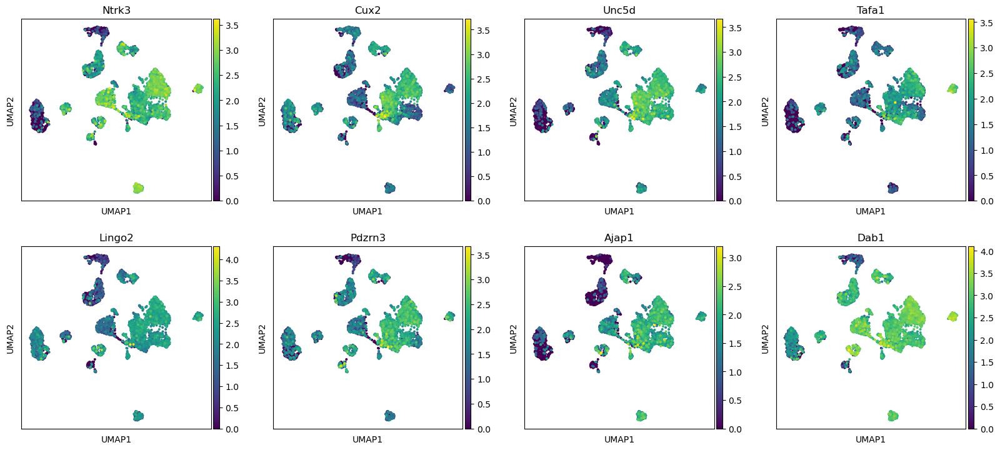

L4


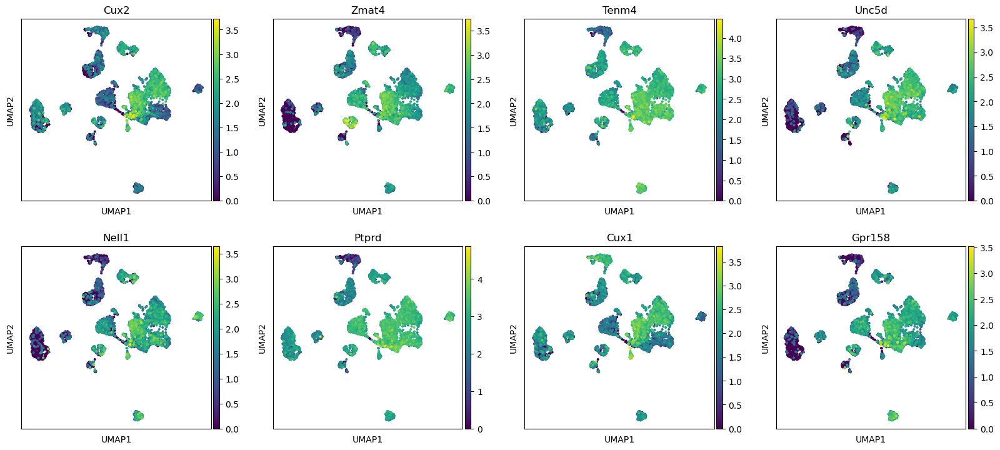

L5 IT


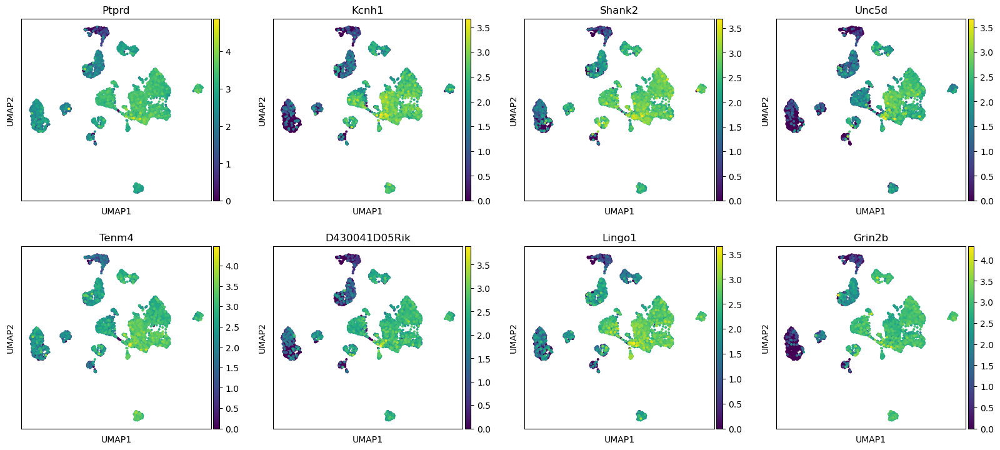

L5 PT


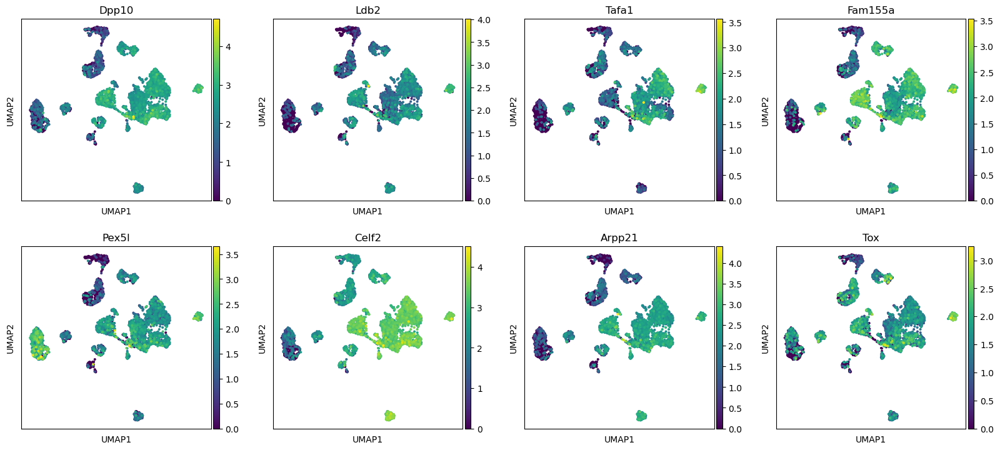

L6 CT


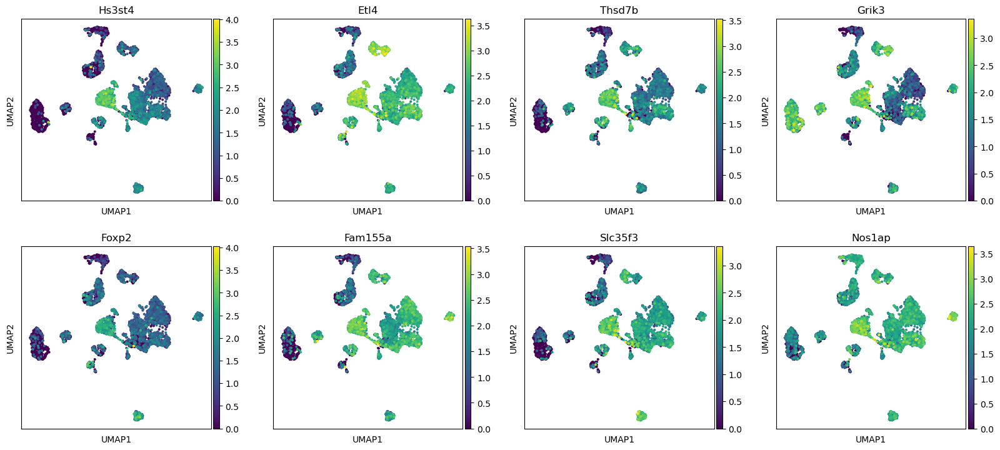

L6 IT


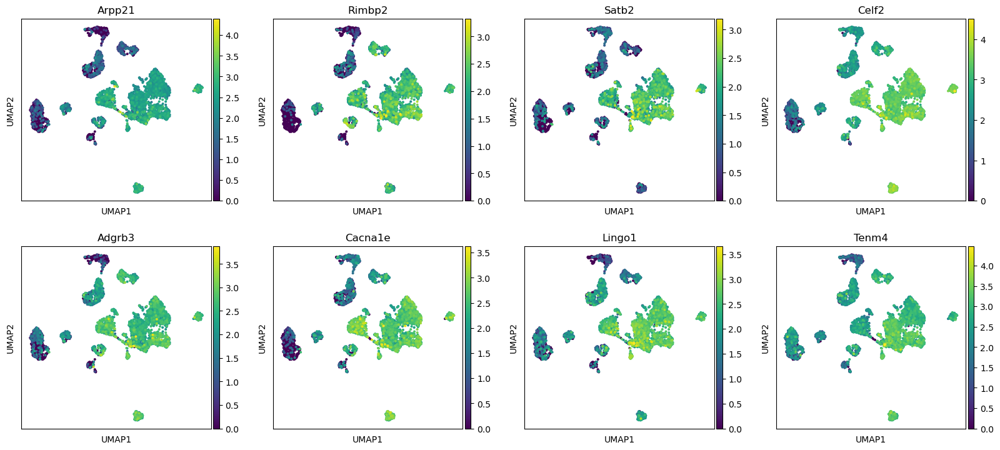

Mature Oligo


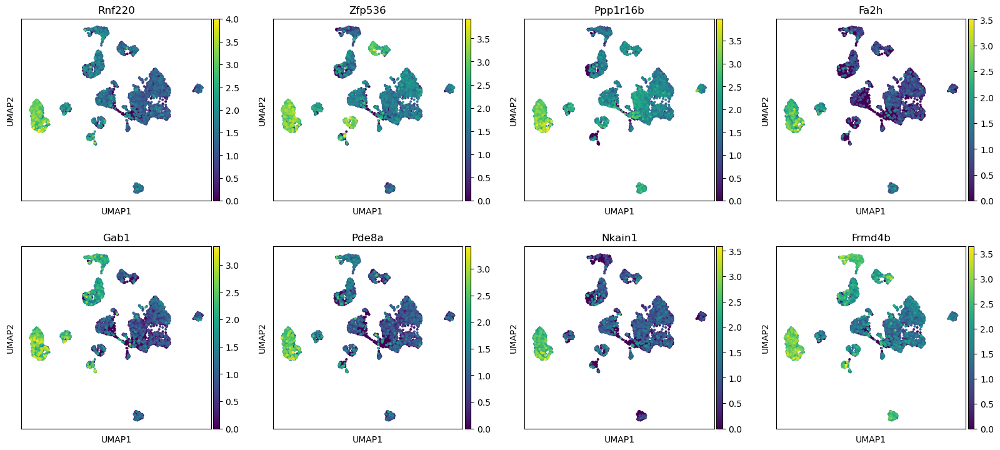

Microglia


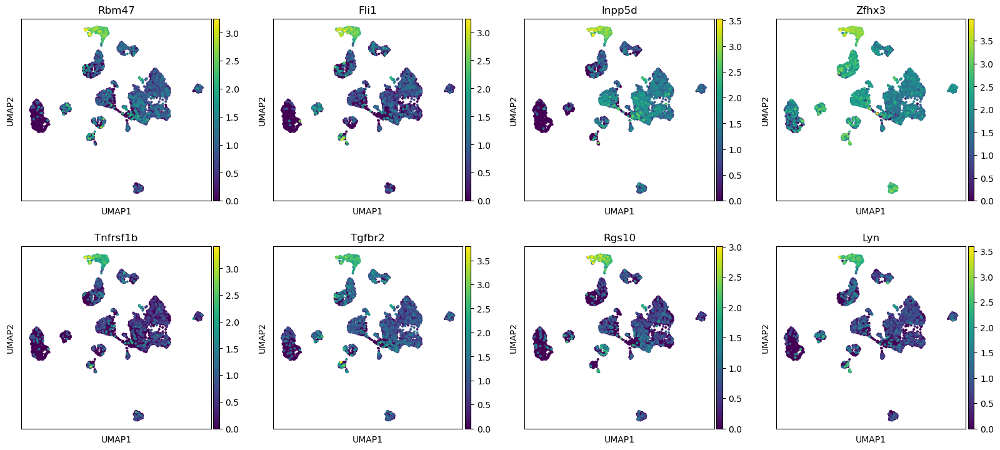

NP


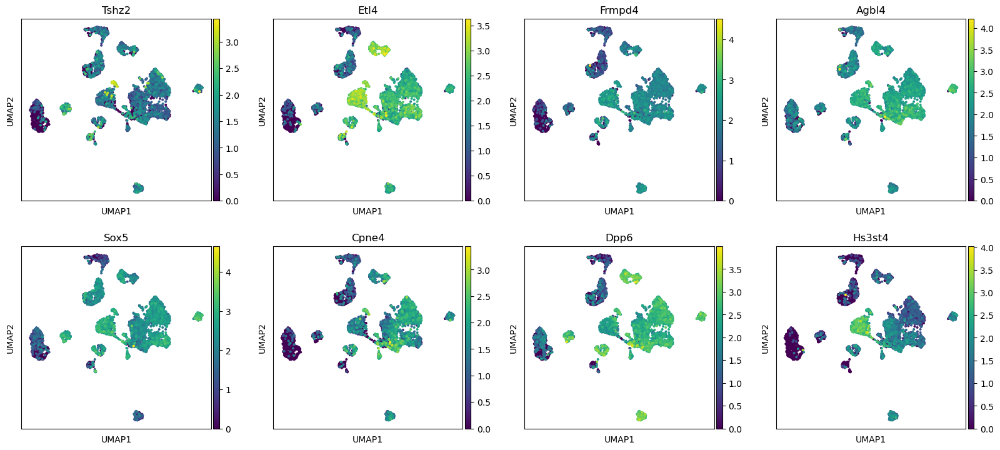

OPCs


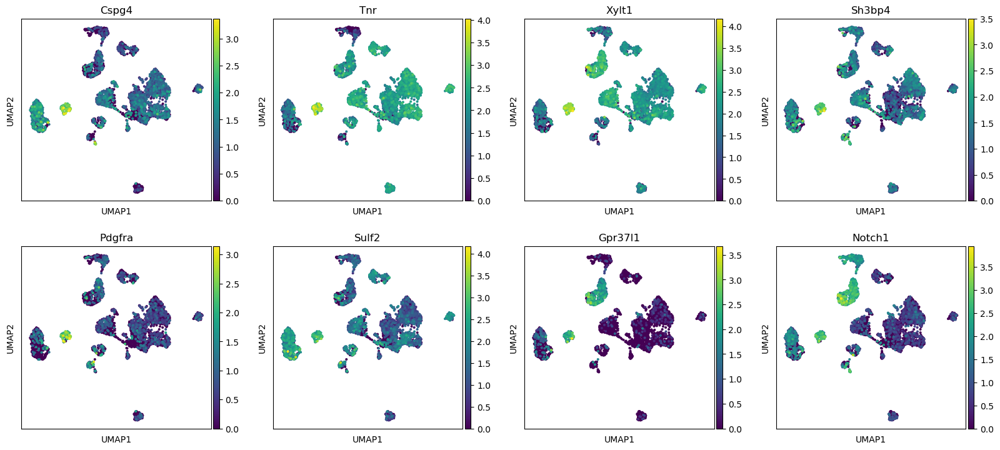

Pvalb


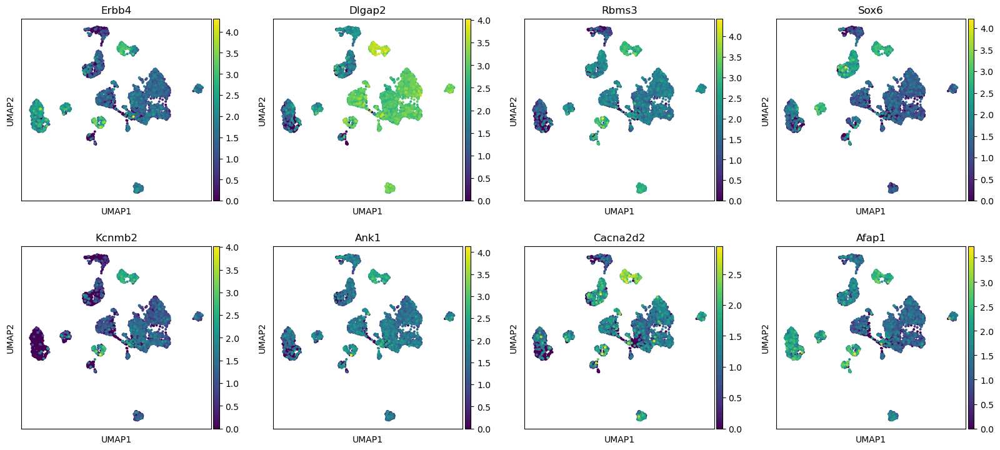

Sst


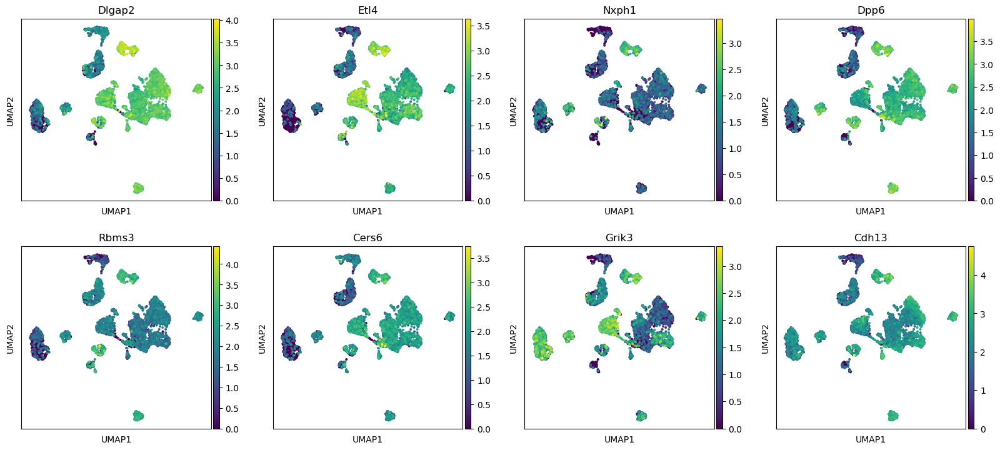

Vip


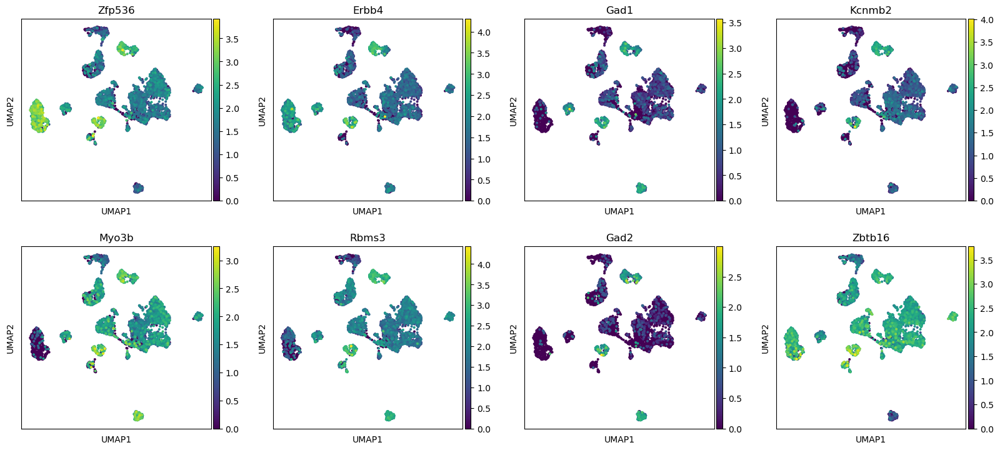

In [89]:
plt.rcParams["figure.figsize"]= (4, 4)

for cell_type, markers in new_markers.items():
    print(cell_type)
    epi.pl.umap(gene_activity, color=markers)

6


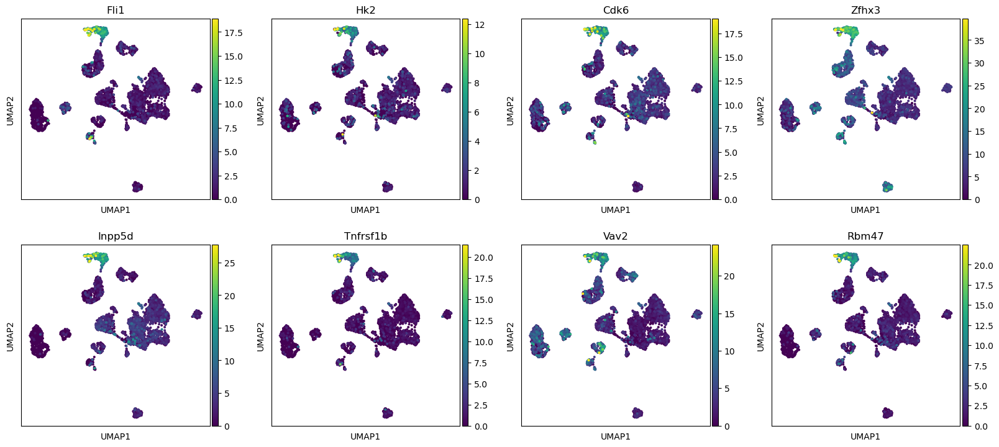

16


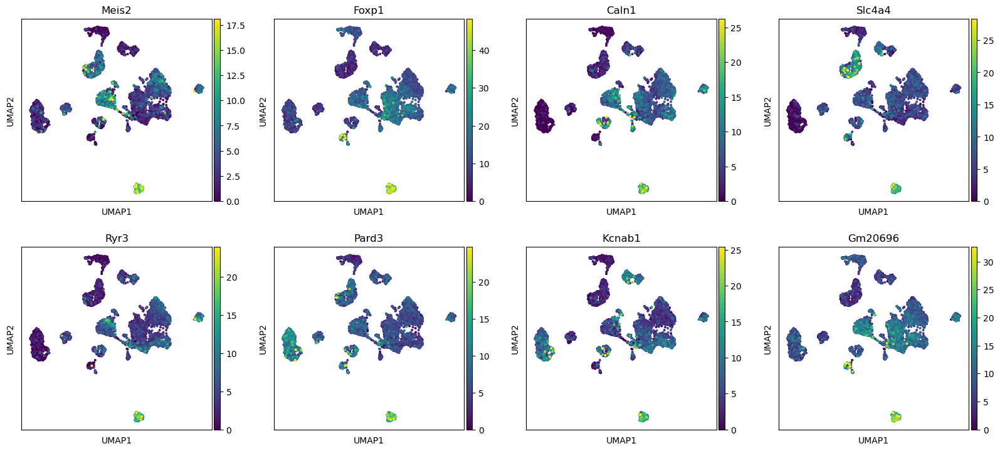

Astrocytes


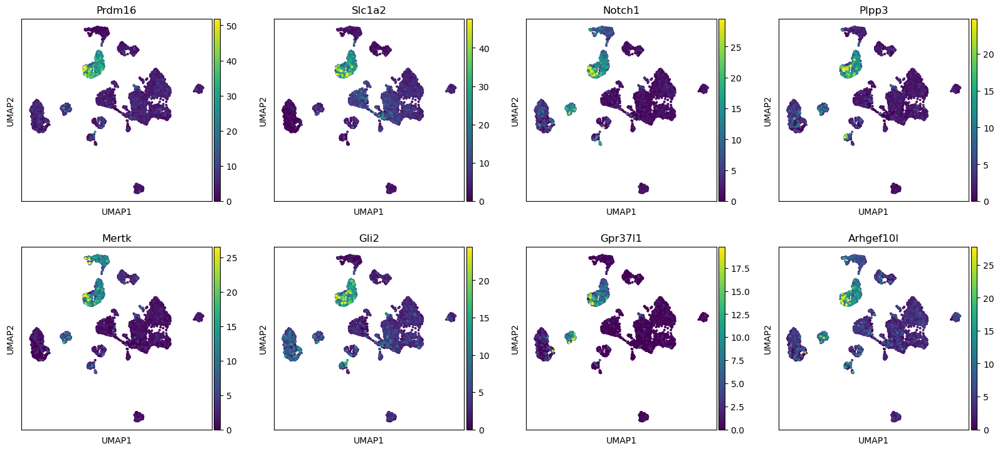

Endo


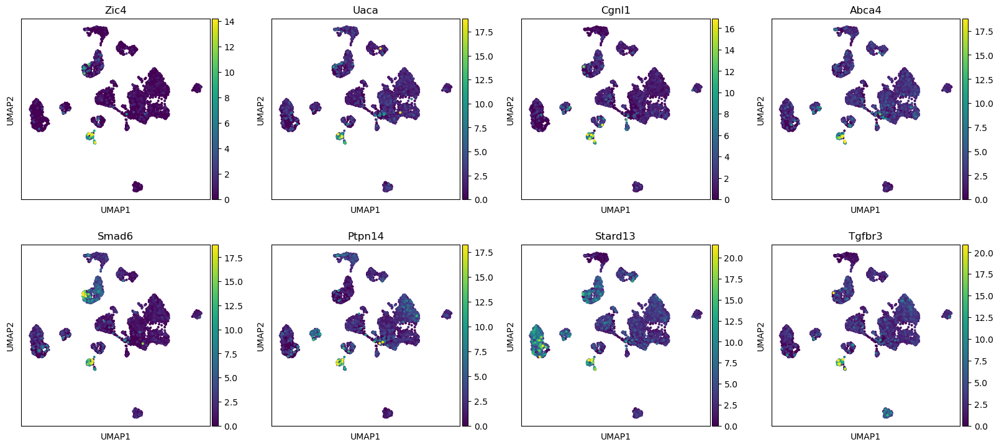

L2/3 IT


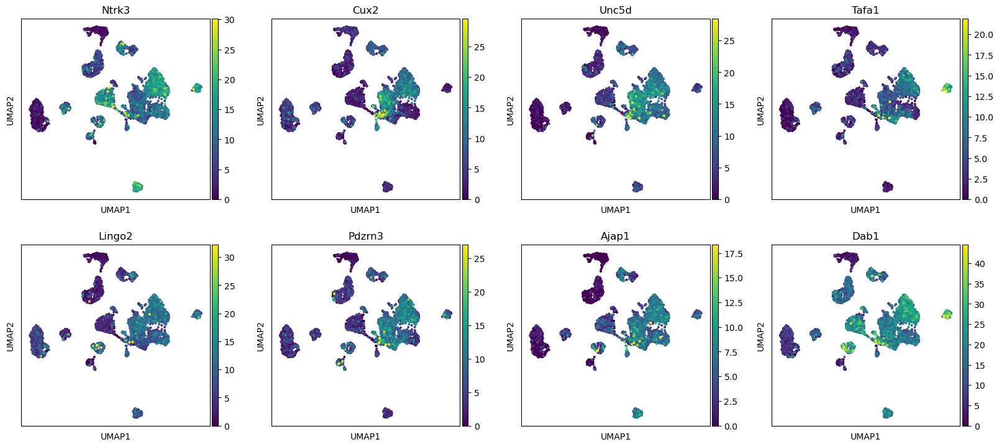

L4


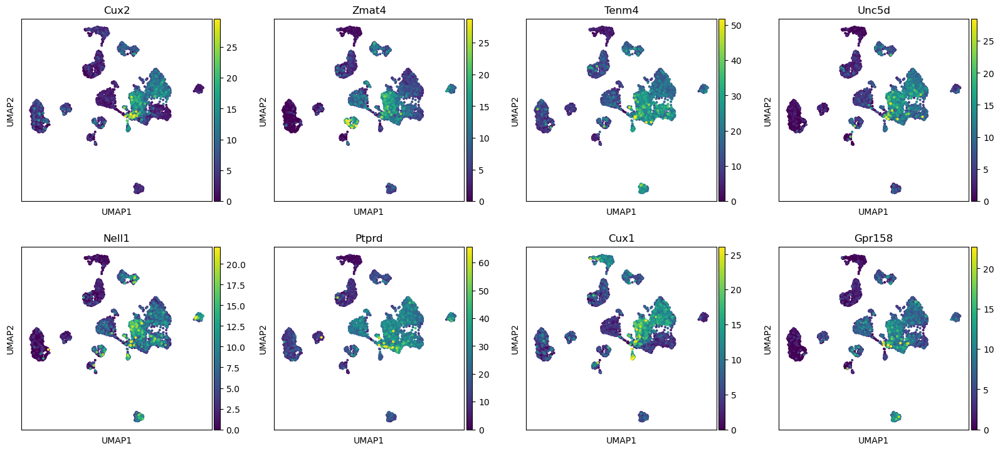

L5 IT


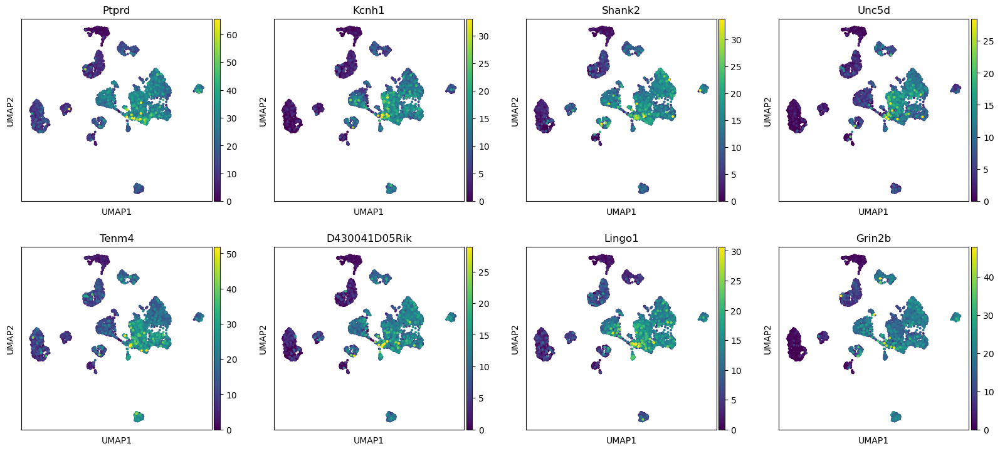

L5 PT


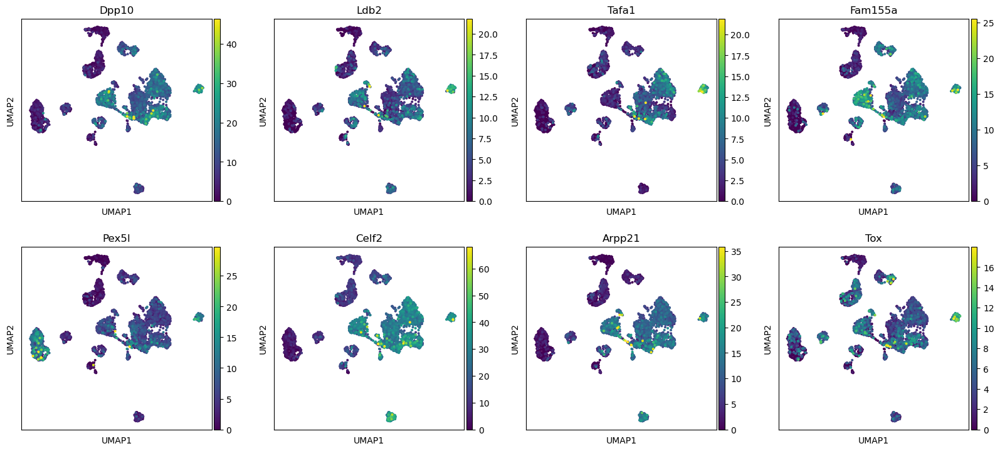

L6 CT


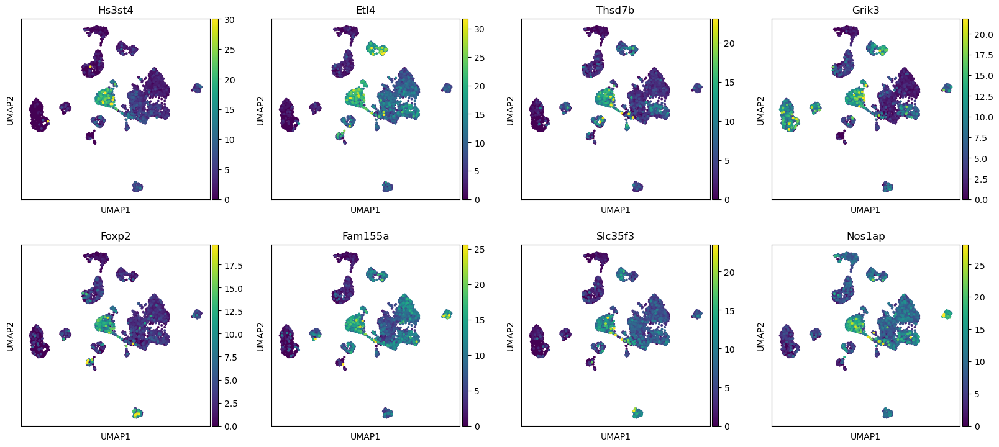

L6 IT


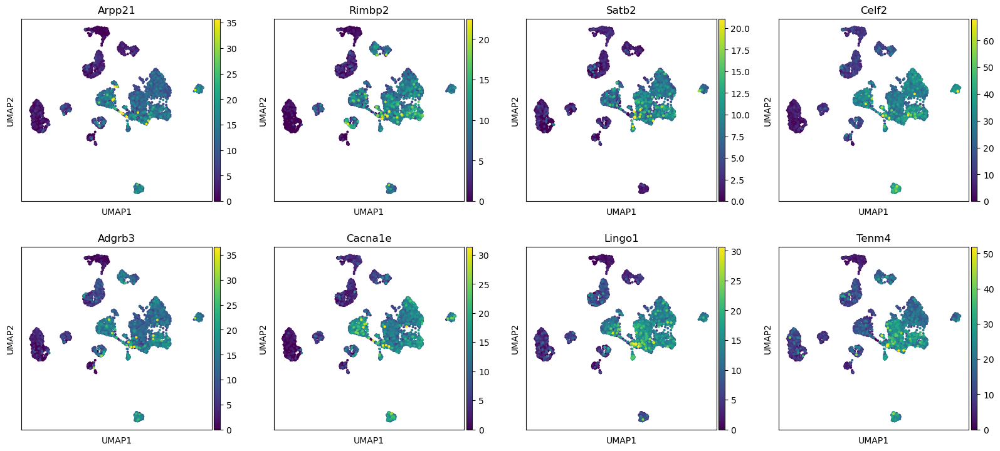

Mature Oligo


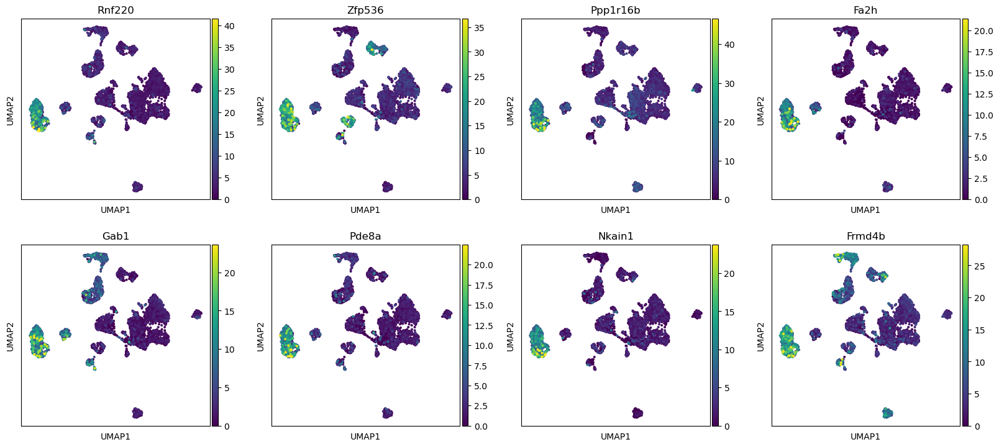

Microglia


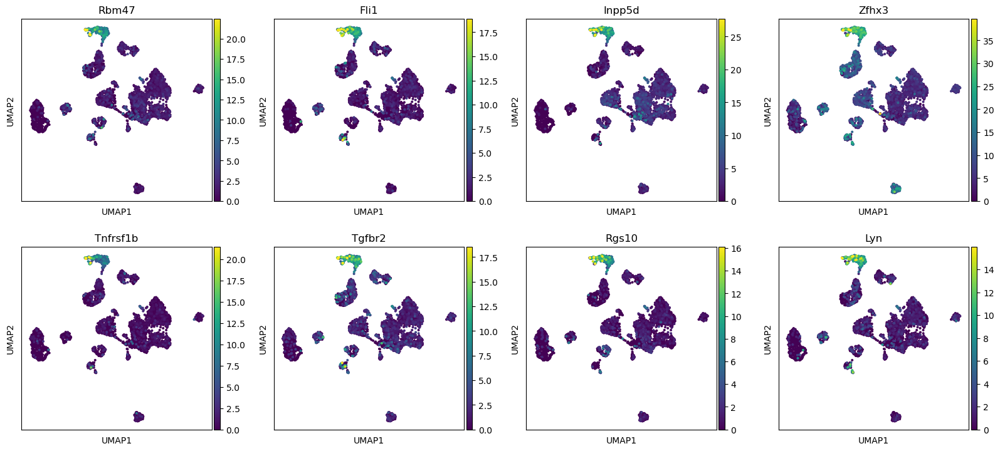

NP


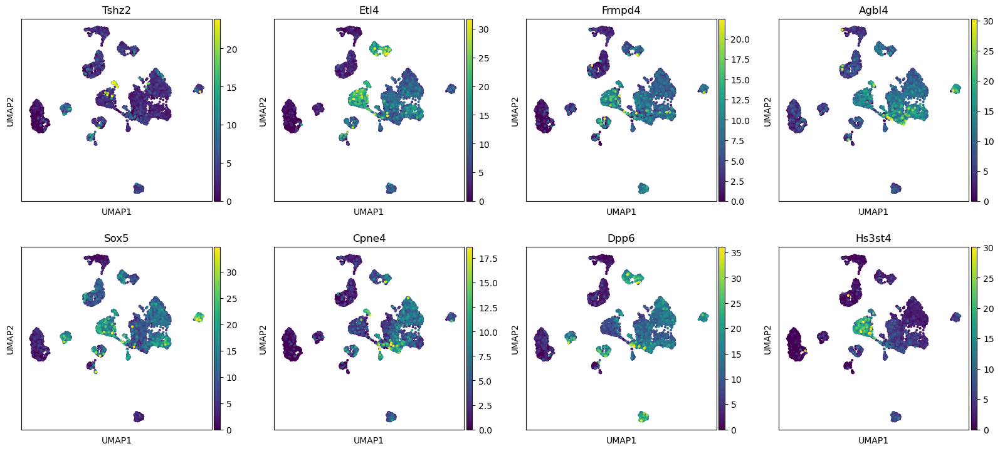

OPCs


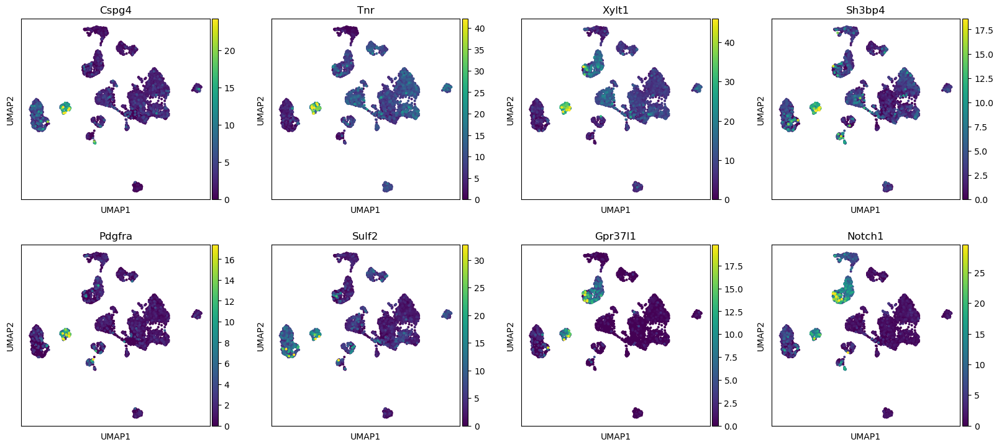

Pvalb


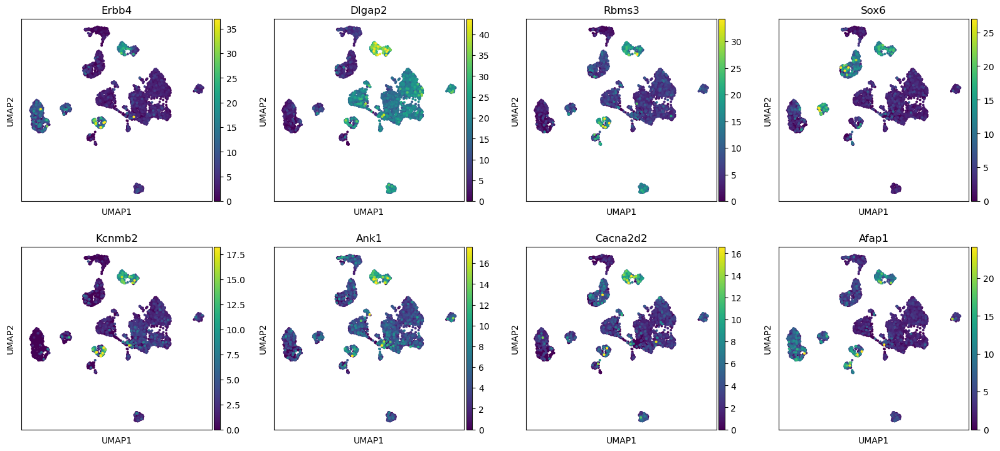

Sst


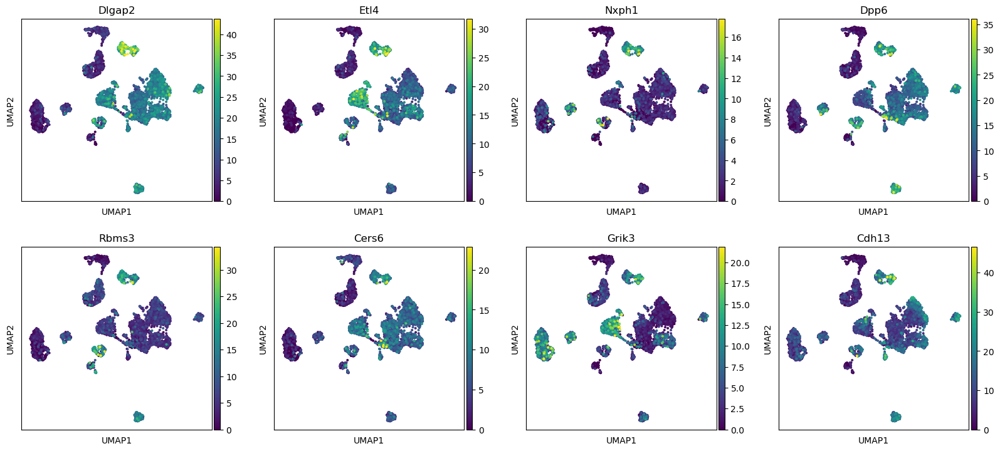

Vip


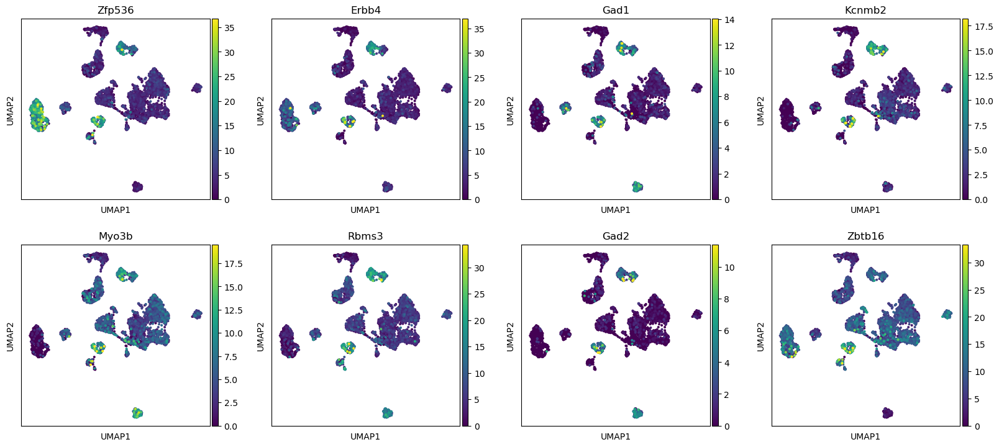

In [90]:
for cell_type, markers in new_markers.items():
    print(cell_type)
    epi.pl.umap(gene_activity, color=markers, layer="normalized", vmax="p99.9")